## Importamos y definimos el directorio y la version 

In [83]:
import numpy as np
import ast
import networkx as nx
import matplotlib.pyplot as plt
from collections import Counter

directorio='G:\\Redes\\'
version=2

## Armamos la red dirigida a partir del archivo filtrado

In [84]:
N=1000000
i=0
G=nx.DiGraph()
archivo = open(directorio+'archivo_red_'+str(version)+'.txt','r',encoding='utf-8')
for line in archivo:
    i+=1
    G.add_edges_from([(line.split()[0],line.split()[1])])
    if i==N:
        break
archivo.close()
print(len(G),i)

72987 63105


## Graficamos la distribución de grado

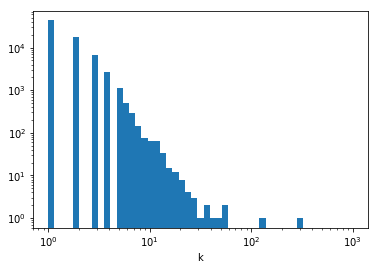

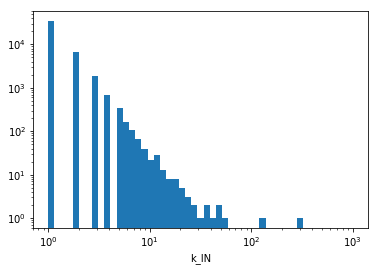

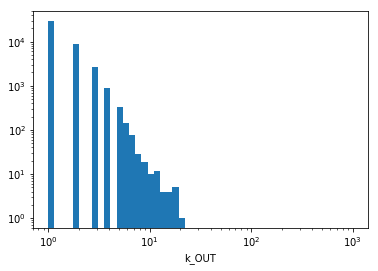

In [85]:
plt.figure()
grados_G = []
grados_G = [gra for n,gra in G.degree()]
Datos = np.asarray(grados_G)
b=np.logspace(0,3,50)
plt.hist(Datos, bins=b, log=True) 
plt.xscale('log')
plt.xlabel('k')
#plt.yscale('log')
plt.show()
plt.figure()
# Distribución de grado IN
grados_G = []
grados_G = [gra for n,gra in G.in_degree()] 
Datos = np.asarray(grados_G)
b=np.logspace(0,3,50)
plt.hist(Datos, bins=b, log=True) 
plt.xscale('log')
plt.xlabel('k_IN')
#plt.yscale('log')
plt.show()
plt.figure()
# Distribución de grado OUT
grados_G = []
grados_G = [gra for n,gra in G.out_degree()]
Datos = np.asarray(grados_G)
b=np.logspace(0,3,50)
plt.hist(Datos, bins=b, log=True) 
plt.xscale('log')
plt.xlabel('k_OUT')
#plt.yscale('log')
plt.show()

## Añadimos el año del paper como atributo a cada nodo

In [86]:
archivo = open(directorio+'archivo_year_'+str(version)+'.txt','r',encoding='utf-8')
i=0
for line in archivo:
    i+=1
    try:
        G.node[line.split()[0]]['year']=int(line.split()[1])
    except KeyError:
        pass
    if i==N:
        break
archivo.close()

## Añadimos el campo de estudio del paper como atributo, eligiendo el más frecuente

In [87]:
archivo = open(directorio+'archivo_fos_'+str(version)+'.txt','r',encoding='utf-8')
i=0
j=0
fos = {}
for line in archivo:
    i+=1
    a=line.split('[')[1].split(']')[0].split(', ')
    for tag in range(len(a)):
            try:
                b=fos[a[tag]]
                b+=1
                fos.update({a[tag]:b})
            except:
                fos[a[tag]]=1
    if i==N:
        break
archivo.close()

In [88]:
archivo = open(directorio+'archivo_fos_'+str(version)+'.txt','r',encoding='utf-8')
i=0
j=0
for line in archivo:
    i+=1
    a=line.split('[')[1].split(']')[0].split(', ')
    freq=np.zeros(len(a))
    try:
        for k in range(len(a)):
            freq[k]=fos[a[k]]
        key=a[np.argmax(freq)]    
        G.node[line.split()[0]]['campo']=key
        j+=1
    except KeyError:
        pass
    if i==N:
        break
archivo.close()

## Armamos una lista de redes de cada año

In [89]:
def red_year(G):
    G_year={}
    for i in range(1850,2019):
        lista_nodos=[]
        for node in G.nodes:
            try:
                KEY=G.nodes[node]['year']<i+1
                if KEY:
                    lista_nodos.append(node)
            except KeyError:
                pass
        G_year[str(i)]=G.subgraph(lista_nodos)
    return(G_year)

In [90]:
G_year=red_year(G)

## Calculamos el tamaño de la red total y la componenete gigante año a año

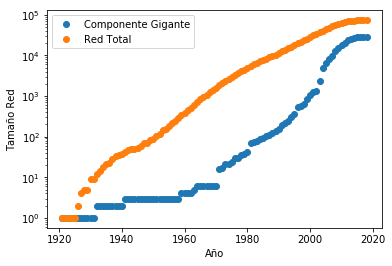

In [91]:
tamanos_gigante=[]
tamanos_red=[]
years=[]
campos=[]
for i in G_year.keys():
    campo=[]
    if len(G_year[i])>0:
        GG=G_year[i].to_undirected()
        Componente=sorted(nx.connected_components(GG), key=len, reverse=True)[0]
        Componente=GG.subgraph(Componente)
        for node in Componente.nodes:
            try:
                campo.append(G.nodes[node]['campo'])
            except KeyError:
                pass
        campos.append(Counter(campo))
        tamanos_gigante.append(len(Componente))
        tamanos_red.append(len(GG))
        years.append(int(i))

plt.semilogy(years,tamanos_gigante,'o',label='Componente Gigante')
plt.semilogy(years,tamanos_red,'o',label='Red Total')

plt.xlabel('Año');plt.ylabel('Tamaño Red');plt.legend()
plt.show()

In [92]:
options = {
'node_size': 2,
'width': .05,
'alpha': .5,
'linewidths':.1
}

In [151]:
pos={}
for node in G.nodes():
    try:
        r = (G.nodes[node]['year']-1900+0.5*np.random.normal())**5
    except KeyError:
        pass
    tita=np.random.random()*2*np.pi
    x=r*np.cos(tita)
    y=r*np.sin(tita)
    pos.update({node:np.array([x,y])})

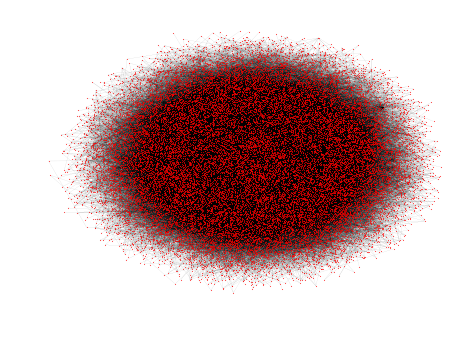

In [152]:
nx.draw(Componente,pos=pos, node_color='red',with_labels=False, **options)

In [153]:
for node in G.nodes():
    try:
        r = (G.nodes[node]['year']-1900+0.5*np.random.normal())**5
    except KeyError:
        pass
    try:
        i=0
        vecinos = [vec for vec in G.neighbors(node)]
        if len(vecinos)>0:
            titas=np.zeros(len(vecinos))
            for vec in vecinos:
                x=pos[vec][0]
                y=pos[vec][1]
                if x>0 and y>=0:
                    titas[i]=np.arctan(y/x)
                elif x==0 and y>0:
                    titas[i]=np.pi*0.5
                elif x<0:
                    titas[i]=np.arctan(y/x)+np.pi
                elif x==0 and y<0:
                    titas[i]=np.pi*1.5
                else:
                    titas[i]=np.arctan(y/x)+2*np.pi
                i+=1
            xs=np.mean(np.cos(titas))
            ys=np.mean(np.sin(titas))
            if xs>0 and ys>=0:
                tita=np.arctan(y/x)
            elif xs==0 and ys>0:
                tita=np.pi*0.5
            elif xs<0:
                tita=np.arctan(y/x)+np.pi
            elif xs==0 and ys<0:
                tita=np.pi*1.5
            else:
                tita=np.arctan(y/x)+2*np.pi
        else:
            tita=np.random.random()*2*np.pi
    except KeyError:
        tita=np.random.random()*2*np.pi
    x=r*np.cos(tita)
    y=r*np.sin(tita)
    pos.update({node:np.array([x,y])})

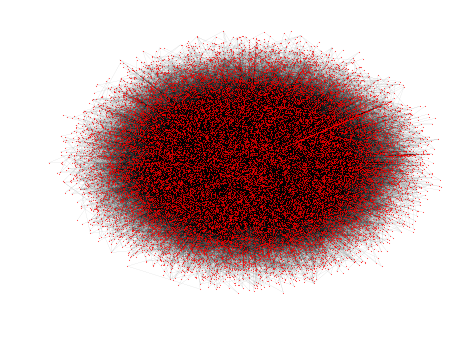

In [154]:
nx.draw(Componente,pos=pos, node_color='red',with_labels=False, **options)

In [147]:
titas=np.array([0,1])
np.cos(titas)**2
np.mean(titas)

0.5

In [108]:
for node in G.nodes():
    try:
        r = (G.nodes[node]['year']-1900 + 0.5*np.random.normal())**5
    except KeyError:
        pass

    try:
        i=0
        vecinos = [vec for vec in G.neighbors(node)]
        for vec in vecinos:
            titas=np.zeros(len(vecinos))
            y=pos[vec][1]
            titas[i]=y
            i+=1
        tita=np.mean(titas)
    except KeyError:
        tita=np.random.random()*2*np.pi
    tita=-np.log(tita/(2*np.pi))
    pos.update({node:np.array([r,tita])})

C:\Users\Usuario\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in log


In [97]:
def frequency(Lista):
    grupo={}
    for line in range(len(Lista)):
        try:
            b=grupo[Lista[line]]
            b+=1
            grupo.update({Lista[line]:b})
        except:
            grupo[Lista[line]]=1
    return(grupo)

In [102]:
import matplotlib.cm as cmx
import imageio
import random
def graficar_red_lims(G,G_year,atributo,ancho,pos,lims,year_year):
    
    Componente=G.copy()
    campos_list=[]
    val_map = {}
    val_map_year = {}
    campos_list_year=[]

    ## Generas una lista de atributo de cada nodo
    for paper in Componente:
        campos_list.append(Componente.node[paper][atributo])
        val_map.update({paper: Componente.node[paper][atributo]})

    for paper in G_year:
        campos_list_year.append(G_year.node[paper][atributo])
        val_map_year.update({paper: G_year.node[paper][atributo]})
    
    grupo={}
    
    x={}
    sorted_by_value = []
    
    ## Asignamos los colores para cada valor de atributo, distinguiendo el año de cualquier otro atributo
    if atributo == 'year':
        y={}
        x=frequency(campos_list)
        
        for line in x.keys():
            y[line]=line
        sorted_by_value = sorted(y.items(), key=lambda kv: kv[1],reverse=True)
    else:   
        x=frequency(campos_list)
        sorted_by_value = sorted(x.items(), key=lambda kv: kv[1],reverse=True)
    
    random.seed(100)
    random.shuffle(sorted_by_value)
    
    cmap =[]
    cmap = cmx.rainbow(np.linspace(0.0, 1.0, len(sorted_by_value)))
 
    ## A cada valor de atributo se le asigna un determinado color
    conversion={}
    for i in range(len(sorted_by_value)):
        conversion.update({sorted_by_value[i][0]: cmap[i]})
  

    ## Asigna un color a cada uno de los nodos de la red G_year (será el mismo para todos)
    color_map =[]  

    for paper in campos_list_year:
        color_map.append(conversion[paper])
   
    
    options = {
    'node_size': 1,
    'width': .05,
    'alpha': .75,
    'linewidths':.1
    }
    
    # Using a figure to use it as a parameter when calling nx.draw_networkx
    f = plt.figure(1)
    ax = f.add_subplot(1,1,1)
    for label in conversion:
        pass
#         ax.plot([ancho],[1],color=conversion[label],label=label,linestyle='',marker='.')
#         ax.legend(loc="lower right", bbox_to_anchor=(0.6,0.5))
    # Just fixed the color map
    nx.draw_networkx(G_year,pos=pos, node_color=color_map,with_labels=False,ax=ax, **options)
    
    # Setting it to how it was looking before.                                                                                                              
    plt.axis('off')
    f.set_facecolor('w')
    plt.title(year_year)
    plt.legend(numpoints = 1)
    f.tight_layout()
    plt.xlim(lims[0])
    plt.ylim(lims[1])
    plt.savefig(directorio+'fig'+year_year+'.png')
    plt.show()

No handles with labels found to put in legend.


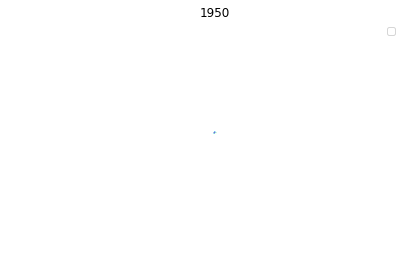

No handles with labels found to put in legend.


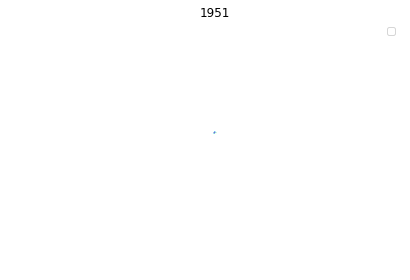

No handles with labels found to put in legend.


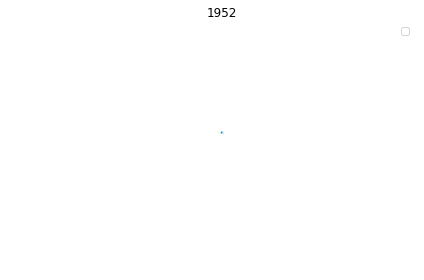

No handles with labels found to put in legend.


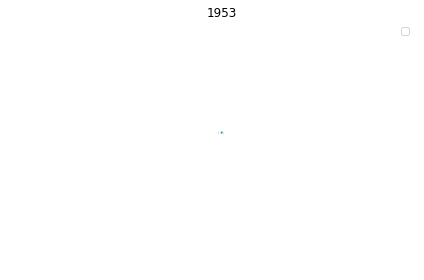

No handles with labels found to put in legend.


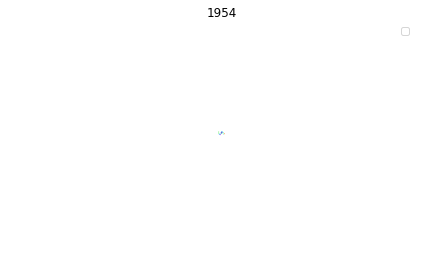

No handles with labels found to put in legend.


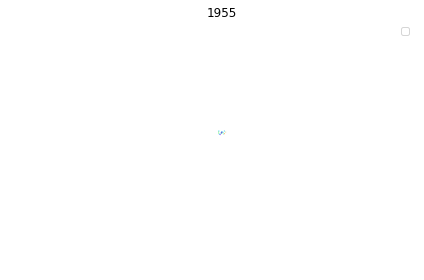

No handles with labels found to put in legend.


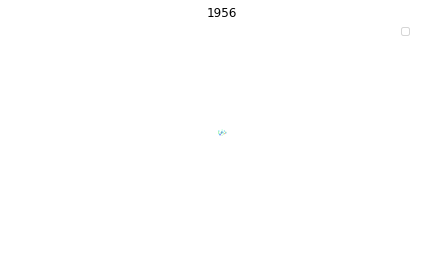

No handles with labels found to put in legend.


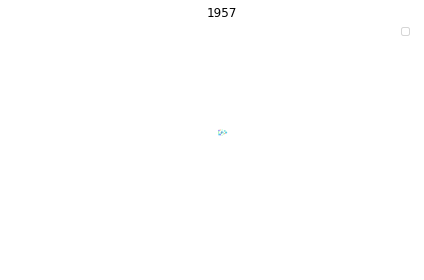

No handles with labels found to put in legend.


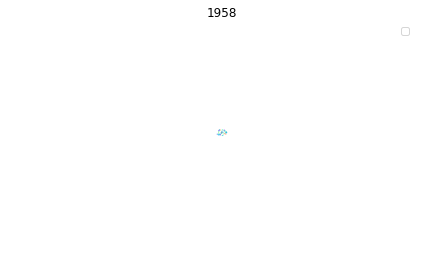

No handles with labels found to put in legend.


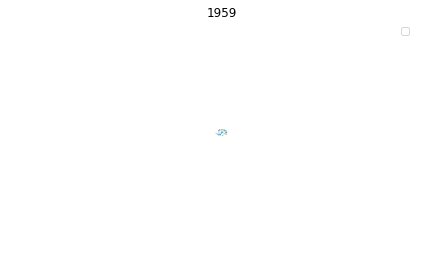

No handles with labels found to put in legend.


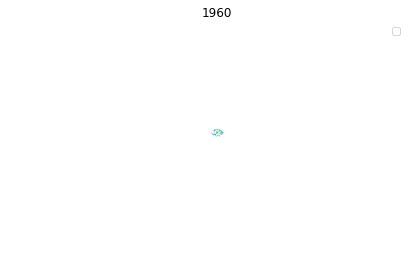

No handles with labels found to put in legend.


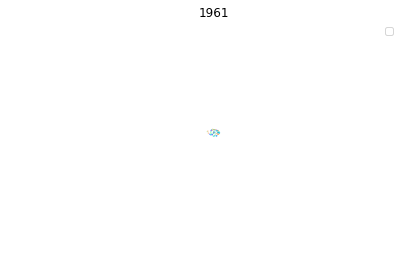

No handles with labels found to put in legend.


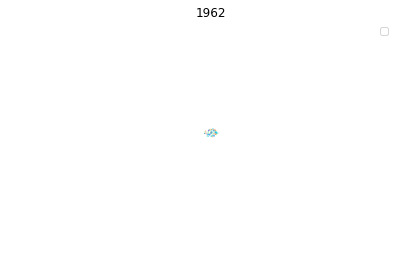

No handles with labels found to put in legend.


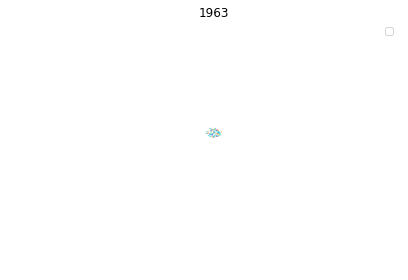

No handles with labels found to put in legend.


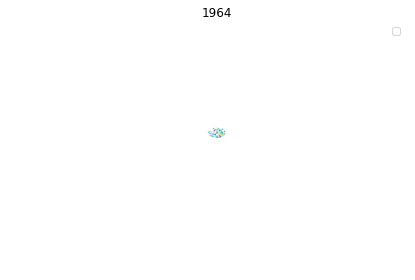

No handles with labels found to put in legend.


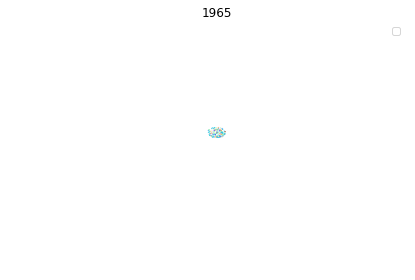

No handles with labels found to put in legend.


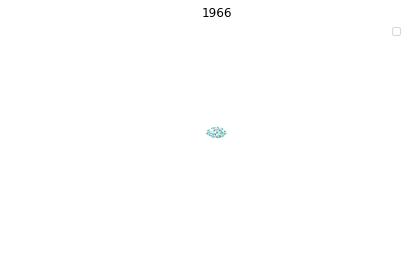

No handles with labels found to put in legend.


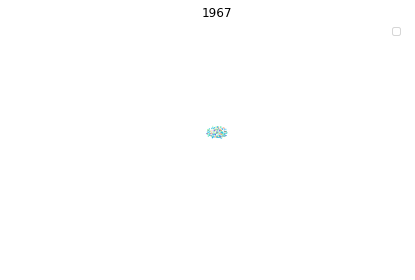

No handles with labels found to put in legend.


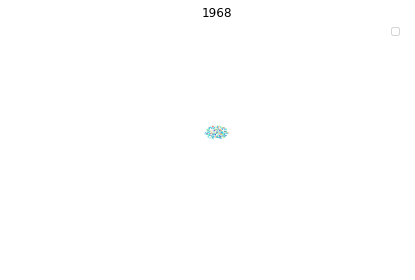

No handles with labels found to put in legend.


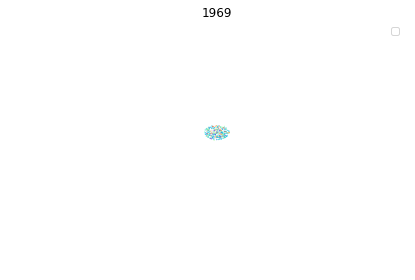

No handles with labels found to put in legend.


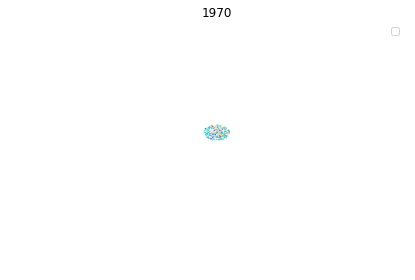

No handles with labels found to put in legend.


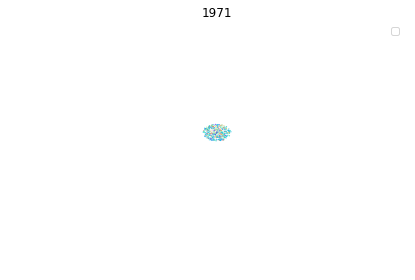

No handles with labels found to put in legend.


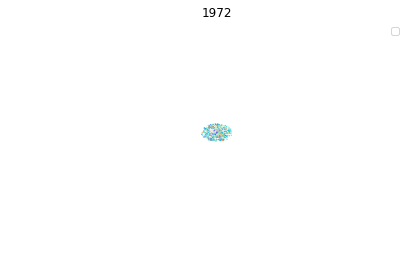

No handles with labels found to put in legend.


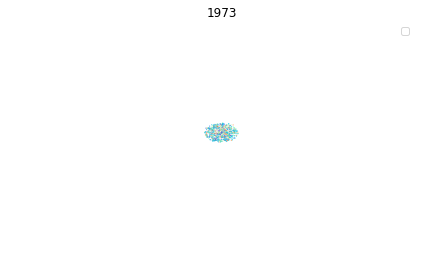

No handles with labels found to put in legend.


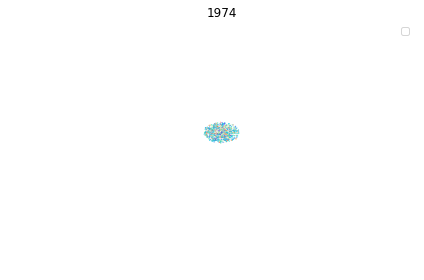

No handles with labels found to put in legend.


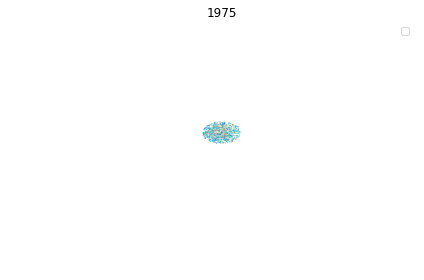

No handles with labels found to put in legend.


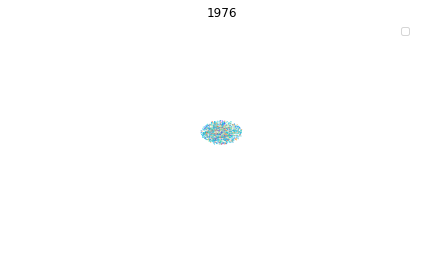

No handles with labels found to put in legend.


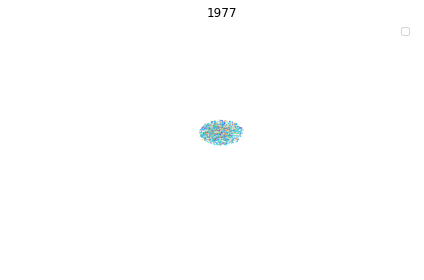

No handles with labels found to put in legend.


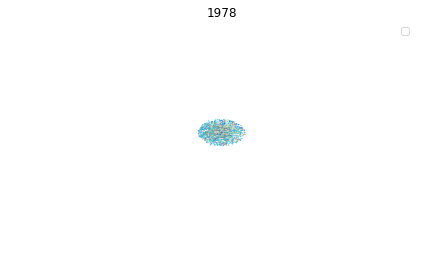

No handles with labels found to put in legend.


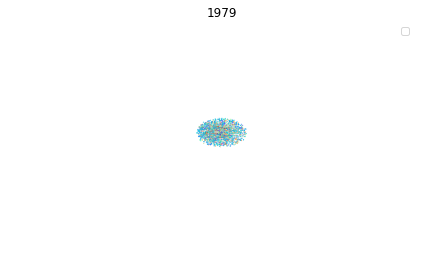

No handles with labels found to put in legend.


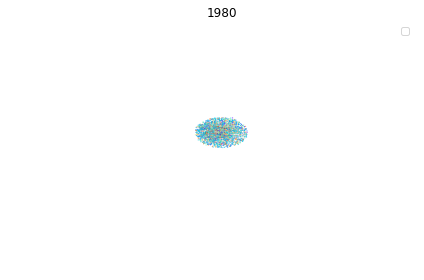

No handles with labels found to put in legend.


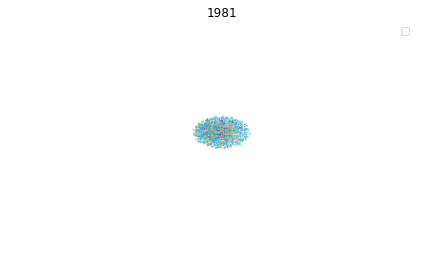

No handles with labels found to put in legend.


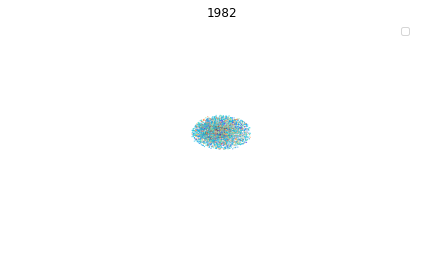

No handles with labels found to put in legend.


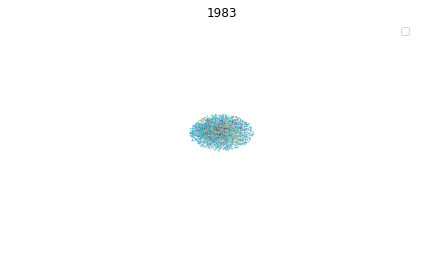

No handles with labels found to put in legend.


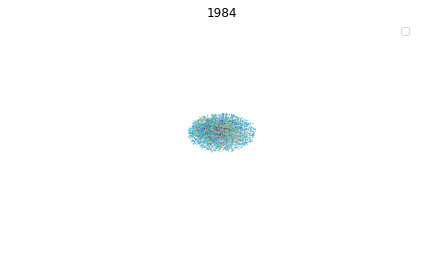

No handles with labels found to put in legend.


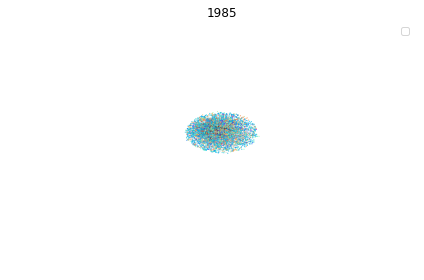

No handles with labels found to put in legend.


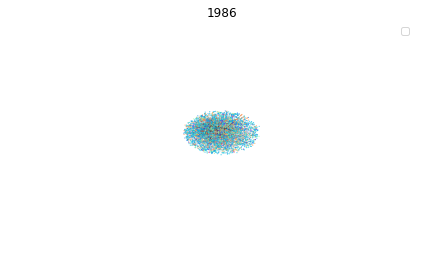

No handles with labels found to put in legend.


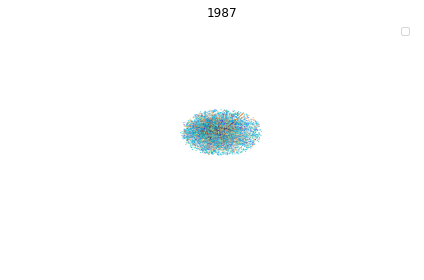

No handles with labels found to put in legend.


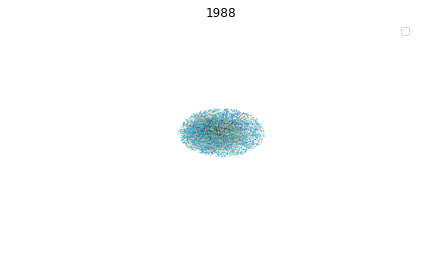

No handles with labels found to put in legend.


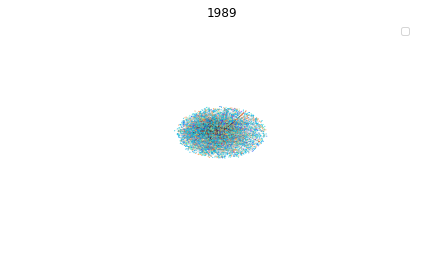

No handles with labels found to put in legend.


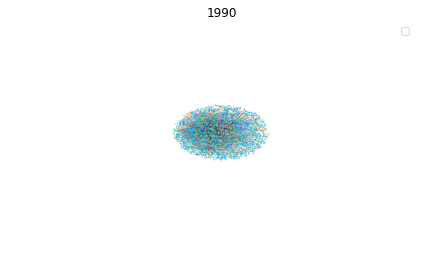

No handles with labels found to put in legend.


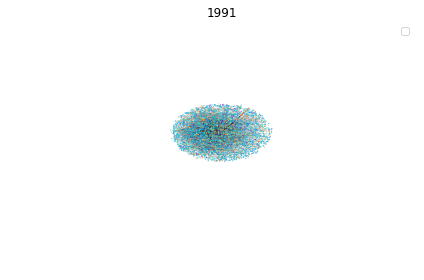

No handles with labels found to put in legend.


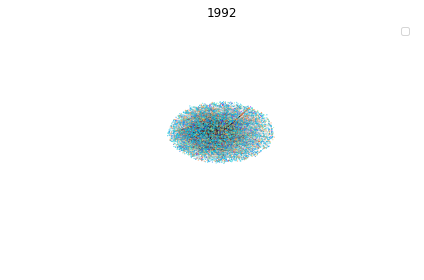

No handles with labels found to put in legend.


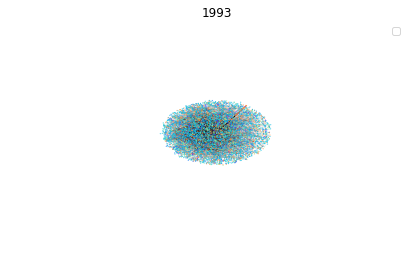

No handles with labels found to put in legend.


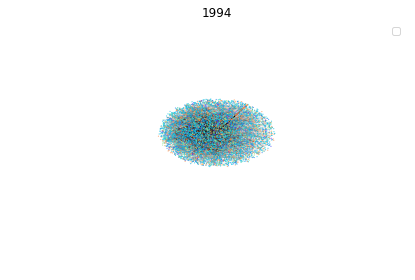

No handles with labels found to put in legend.


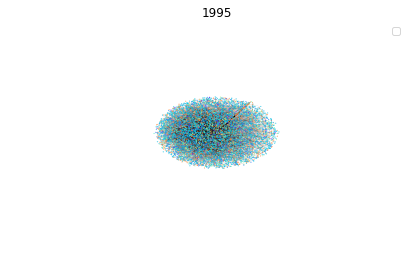

No handles with labels found to put in legend.


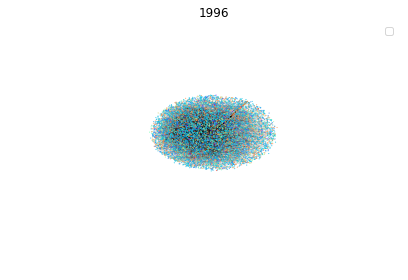

No handles with labels found to put in legend.


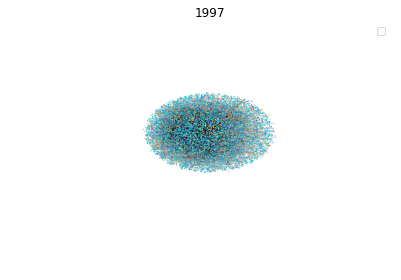

No handles with labels found to put in legend.


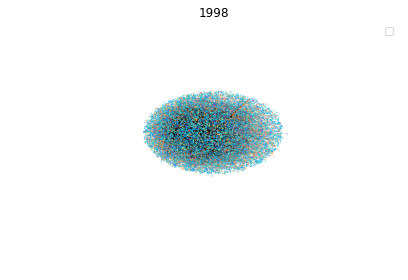

No handles with labels found to put in legend.


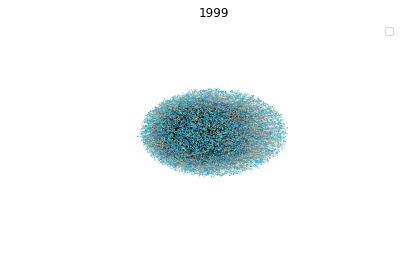

No handles with labels found to put in legend.


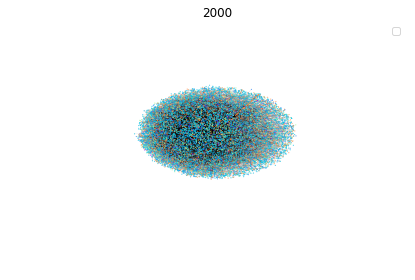

No handles with labels found to put in legend.


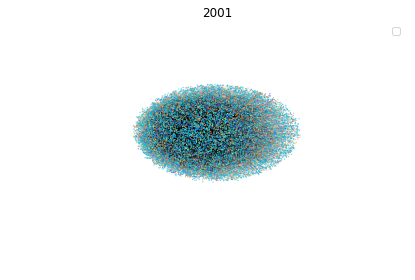

No handles with labels found to put in legend.


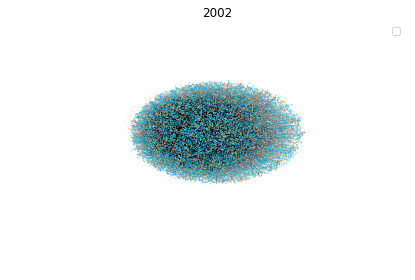

No handles with labels found to put in legend.


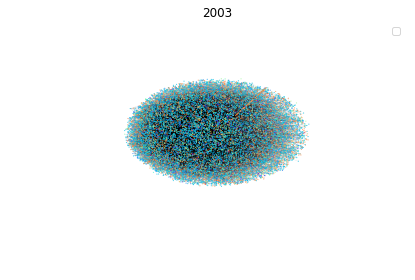

No handles with labels found to put in legend.


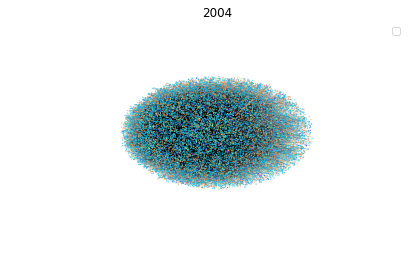

No handles with labels found to put in legend.


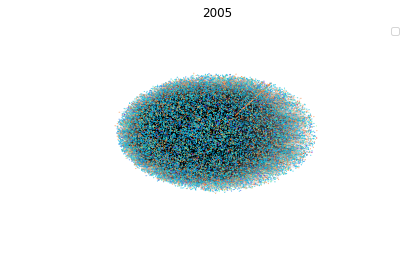

No handles with labels found to put in legend.


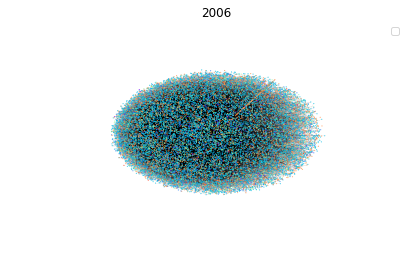

No handles with labels found to put in legend.


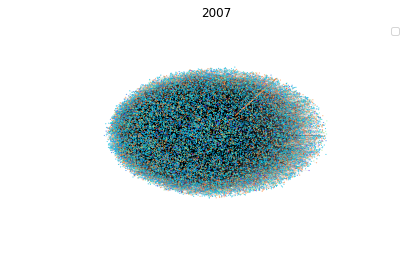

No handles with labels found to put in legend.


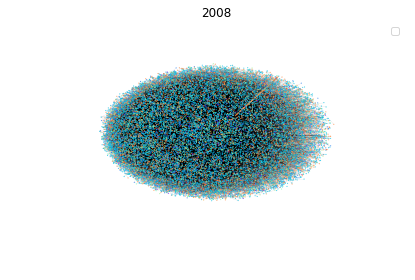

No handles with labels found to put in legend.


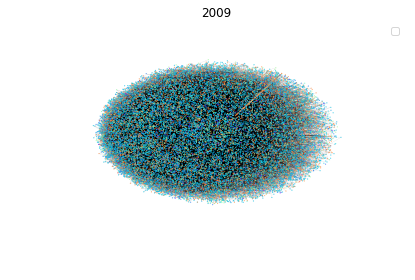

No handles with labels found to put in legend.


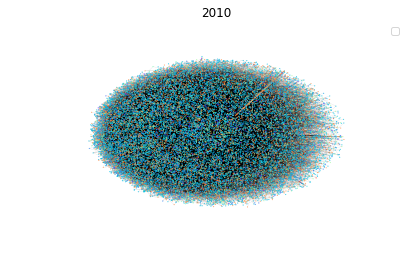

No handles with labels found to put in legend.


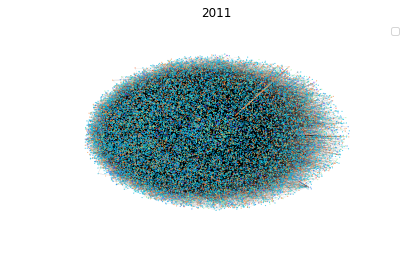

No handles with labels found to put in legend.


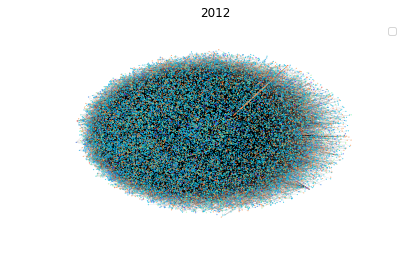

No handles with labels found to put in legend.


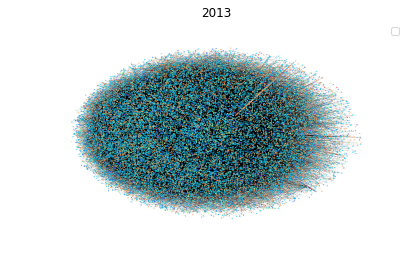

No handles with labels found to put in legend.


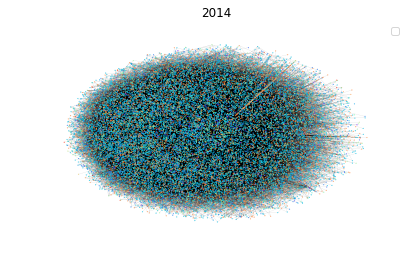

No handles with labels found to put in legend.


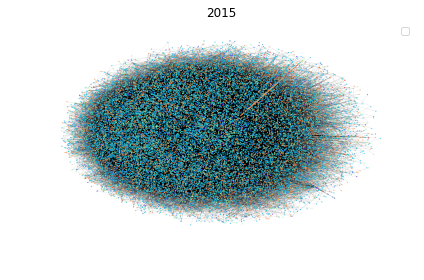

No handles with labels found to put in legend.


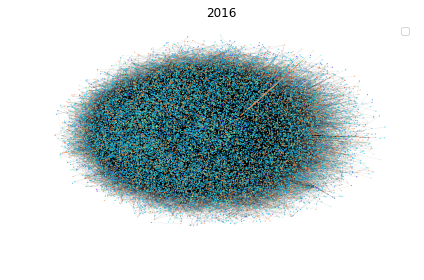

No handles with labels found to put in legend.


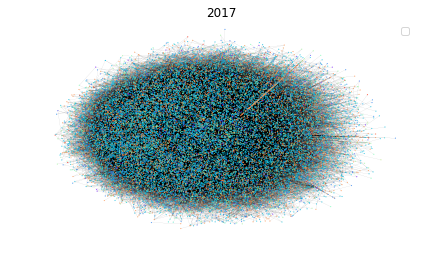

No handles with labels found to put in legend.


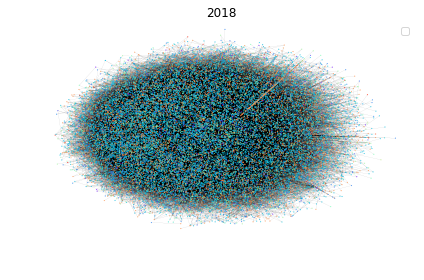

In [103]:
images=[]
version=8
for i in range(1950,2019):
    graficar_red_lims(Componente,G_year[str(i)],'campo',1,pos,[(-(2019-1900 + 1)**5,(2019-1900 + 1)**5),(-(2019-1900 + 1)**5,(2019-1900 + 1)**5)],str(i))
    images.append(imageio.imread(directorio+'fig'+str(i)+'.png'))
    images.append(imageio.imread(directorio+'fig'+str(i)+'.png'))
Final=50
for i in range(Final):
    images.append(imageio.imread(directorio+'fig'+str(2018)+'.png'))

imageio.mimsave(directorio+'Campos'+str(version)+'.gif', images)

No handles with labels found to put in legend.


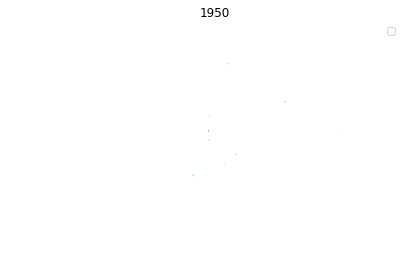

No handles with labels found to put in legend.


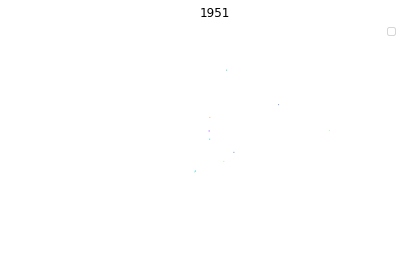

No handles with labels found to put in legend.


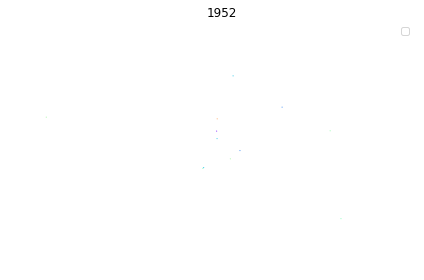

No handles with labels found to put in legend.


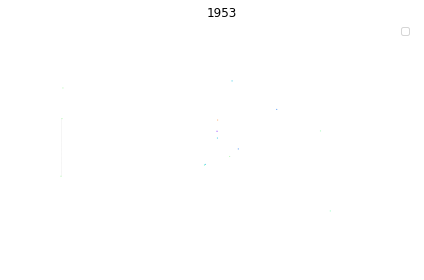

No handles with labels found to put in legend.


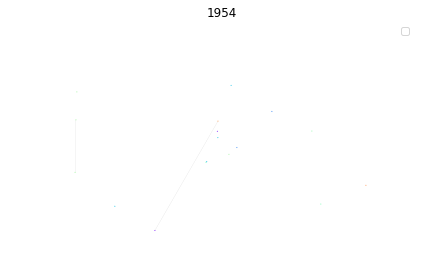

No handles with labels found to put in legend.


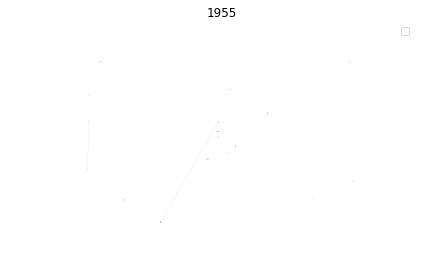

No handles with labels found to put in legend.


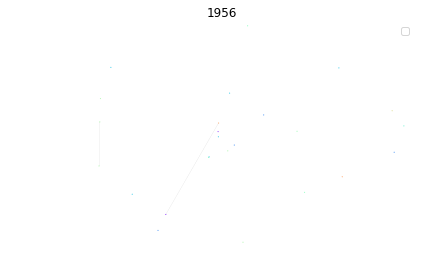

No handles with labels found to put in legend.


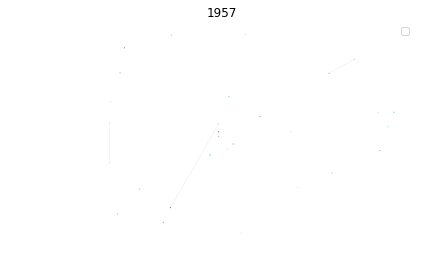

No handles with labels found to put in legend.


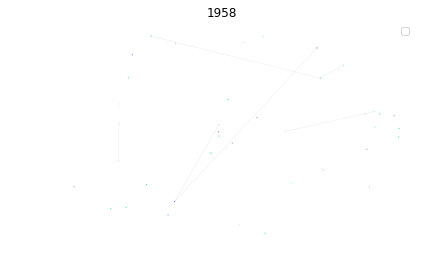

No handles with labels found to put in legend.


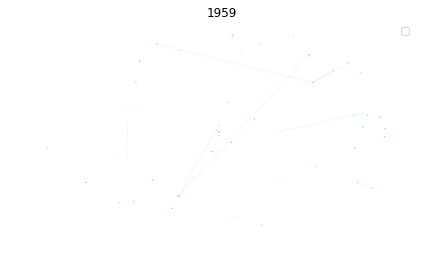

No handles with labels found to put in legend.


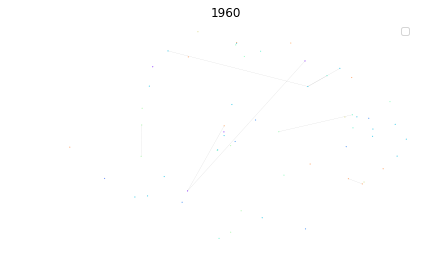

No handles with labels found to put in legend.


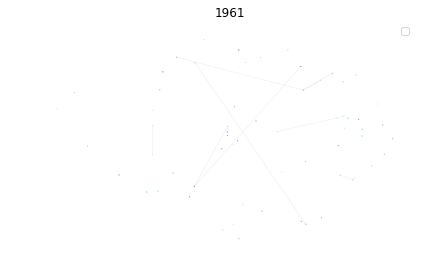

No handles with labels found to put in legend.


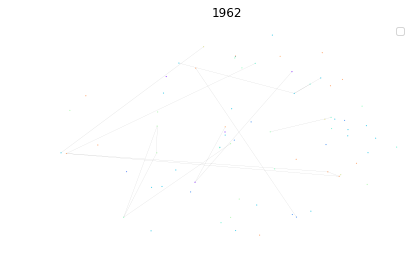

No handles with labels found to put in legend.


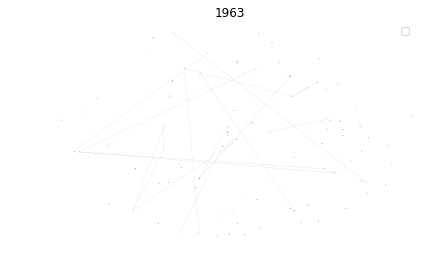

No handles with labels found to put in legend.


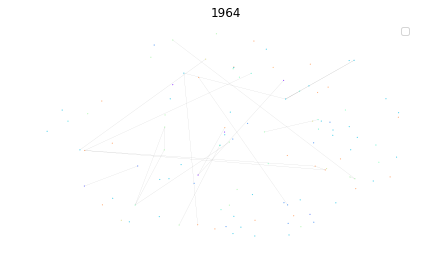

No handles with labels found to put in legend.


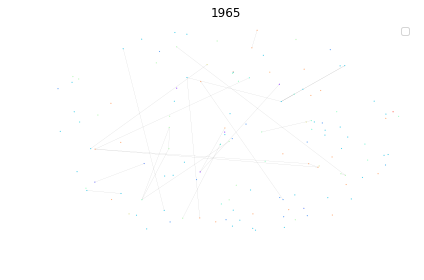

No handles with labels found to put in legend.


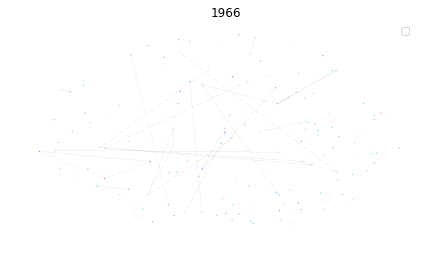

No handles with labels found to put in legend.


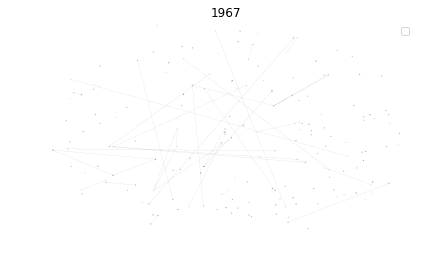

No handles with labels found to put in legend.


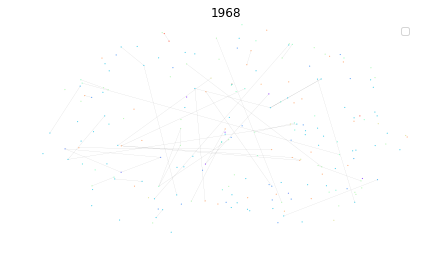

No handles with labels found to put in legend.


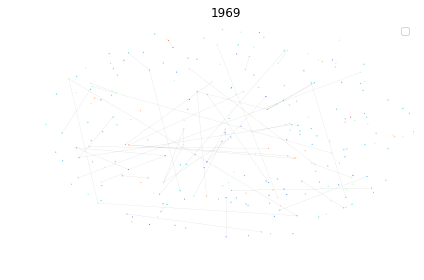

No handles with labels found to put in legend.


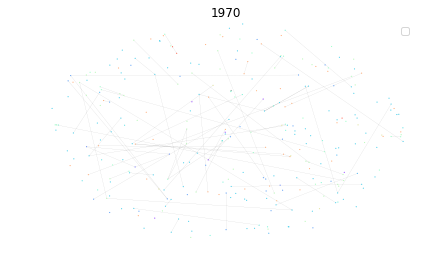

No handles with labels found to put in legend.


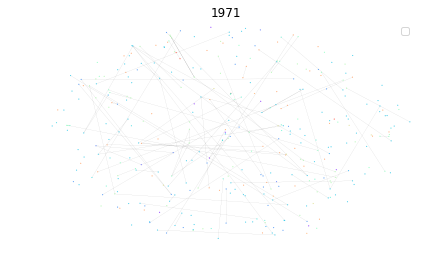

No handles with labels found to put in legend.


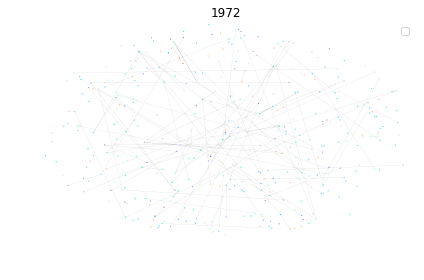

No handles with labels found to put in legend.


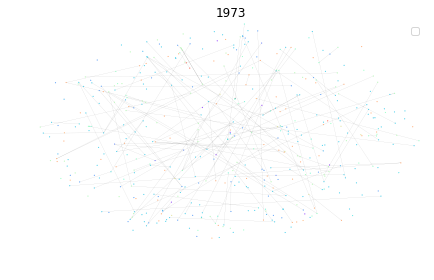

No handles with labels found to put in legend.


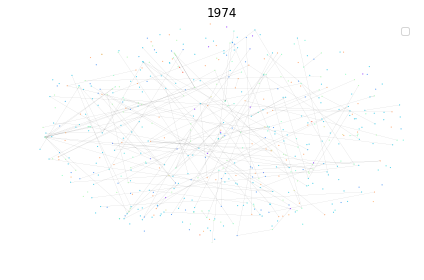

No handles with labels found to put in legend.


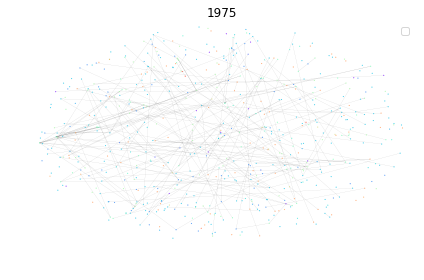

No handles with labels found to put in legend.


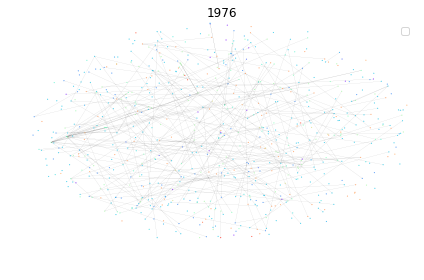

No handles with labels found to put in legend.


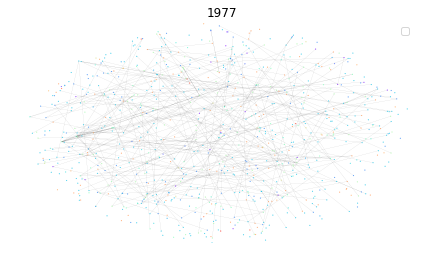

No handles with labels found to put in legend.


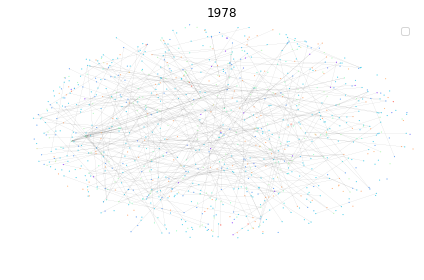

No handles with labels found to put in legend.


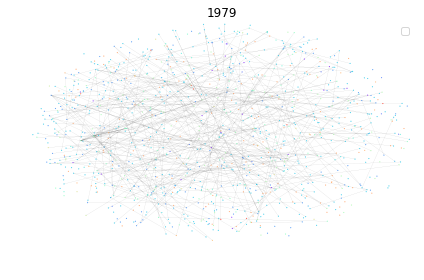

No handles with labels found to put in legend.


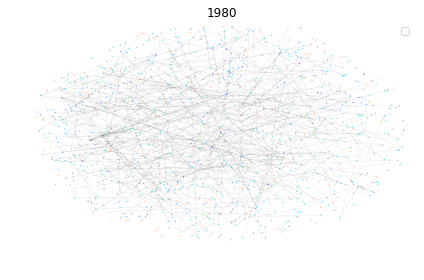

No handles with labels found to put in legend.


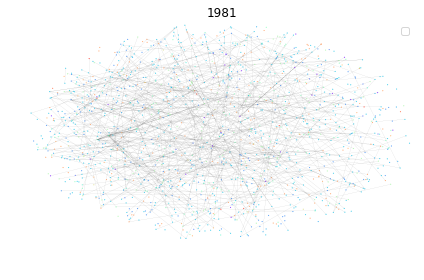

No handles with labels found to put in legend.


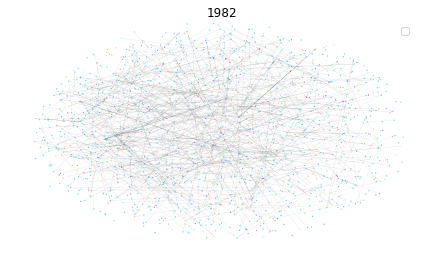

No handles with labels found to put in legend.


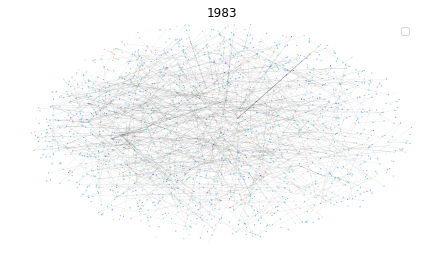

No handles with labels found to put in legend.


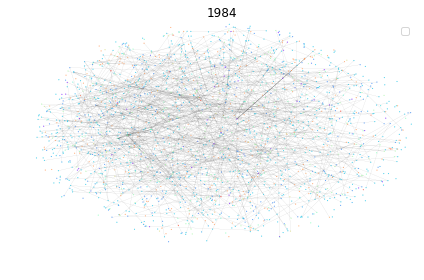

No handles with labels found to put in legend.


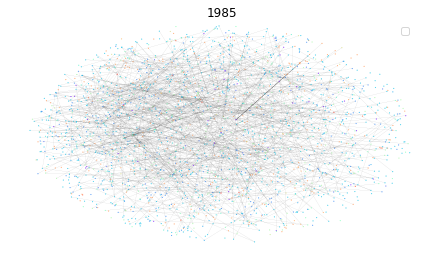

No handles with labels found to put in legend.


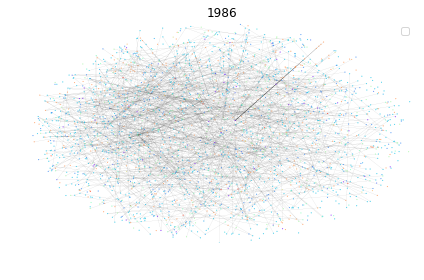

No handles with labels found to put in legend.


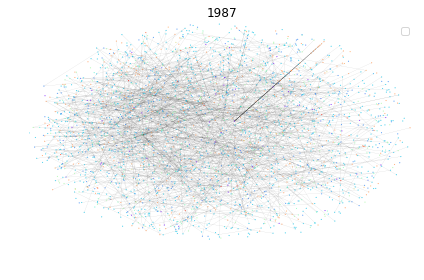

No handles with labels found to put in legend.


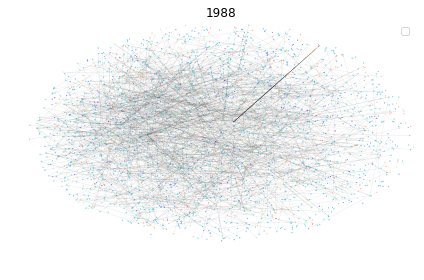

No handles with labels found to put in legend.


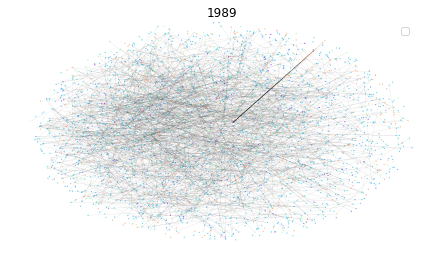

No handles with labels found to put in legend.


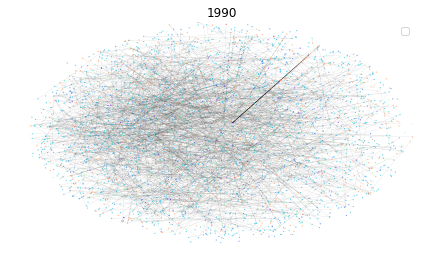

No handles with labels found to put in legend.


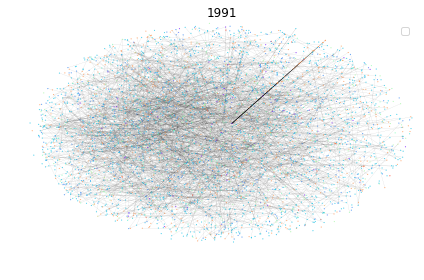

No handles with labels found to put in legend.


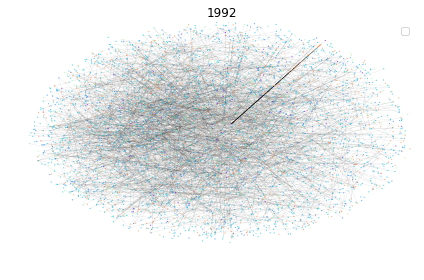

No handles with labels found to put in legend.


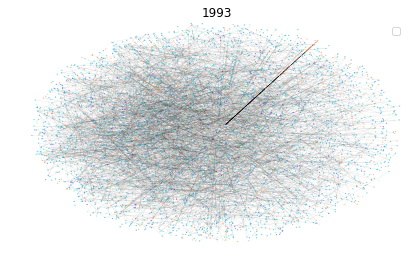

No handles with labels found to put in legend.


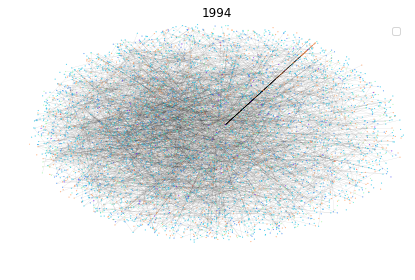

No handles with labels found to put in legend.


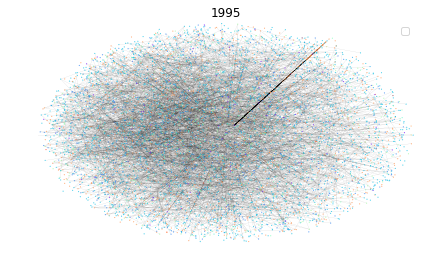

No handles with labels found to put in legend.


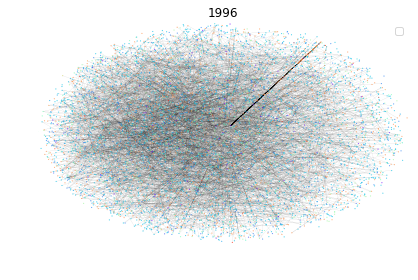

No handles with labels found to put in legend.


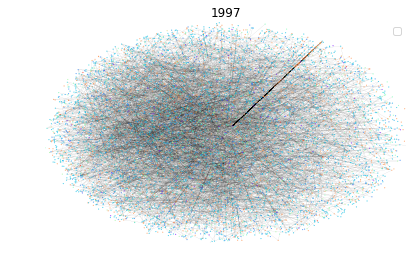

No handles with labels found to put in legend.


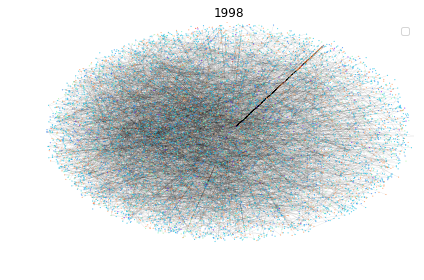

No handles with labels found to put in legend.


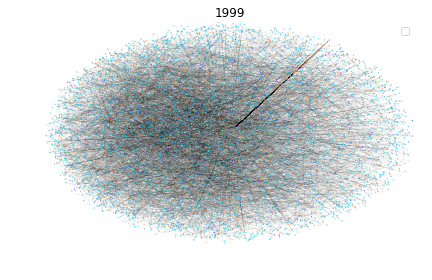

No handles with labels found to put in legend.


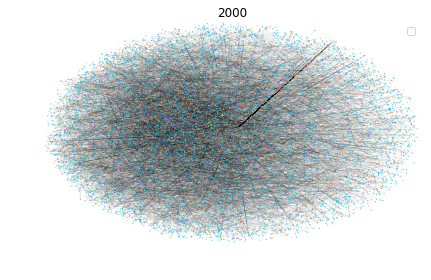

No handles with labels found to put in legend.


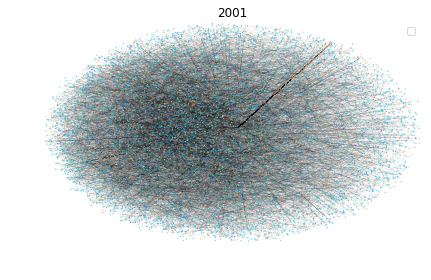

No handles with labels found to put in legend.


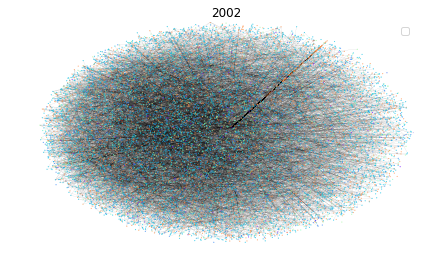

No handles with labels found to put in legend.


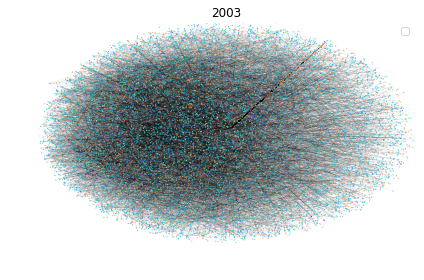

No handles with labels found to put in legend.


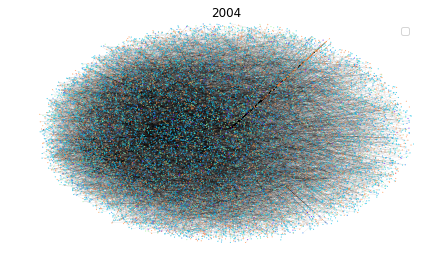

No handles with labels found to put in legend.


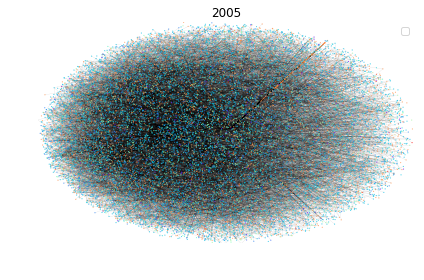

No handles with labels found to put in legend.


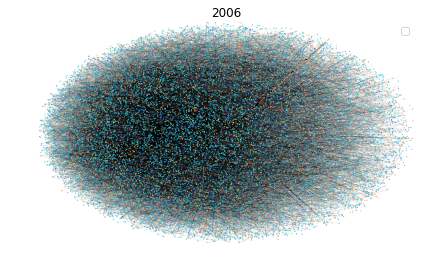

No handles with labels found to put in legend.


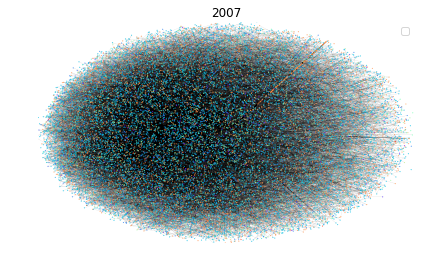

No handles with labels found to put in legend.


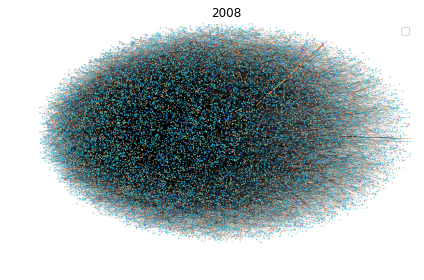

No handles with labels found to put in legend.


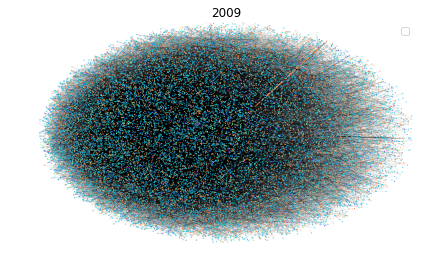

No handles with labels found to put in legend.


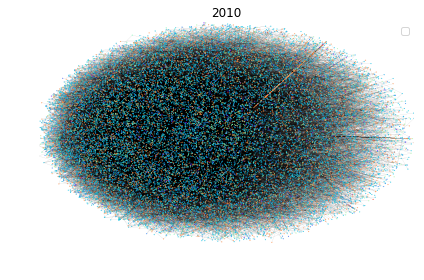

No handles with labels found to put in legend.


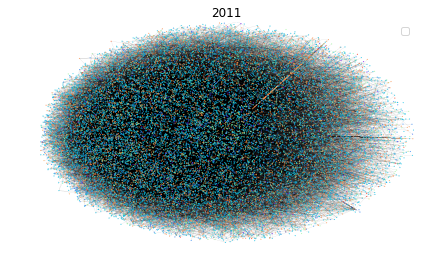

No handles with labels found to put in legend.


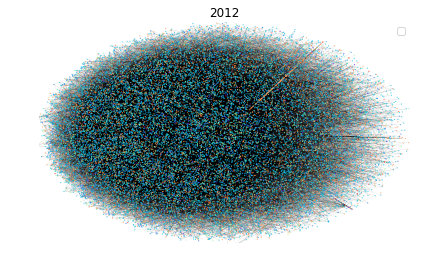

No handles with labels found to put in legend.


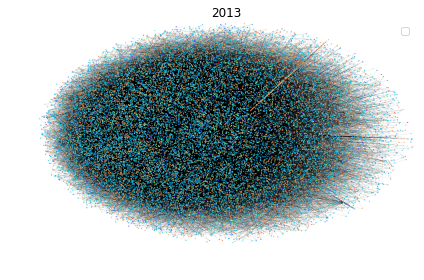

No handles with labels found to put in legend.


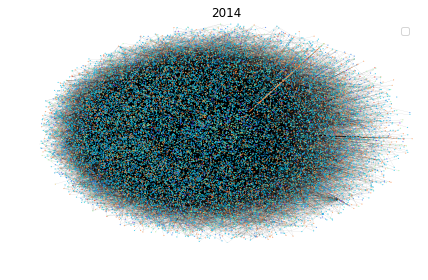

No handles with labels found to put in legend.


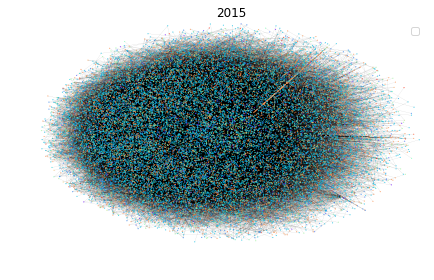

No handles with labels found to put in legend.


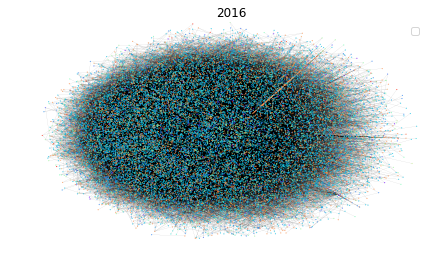

No handles with labels found to put in legend.


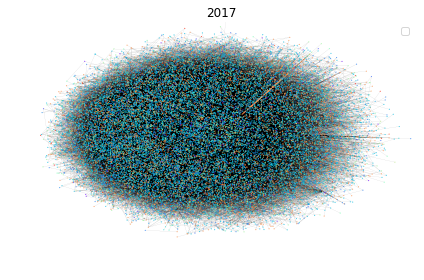

No handles with labels found to put in legend.


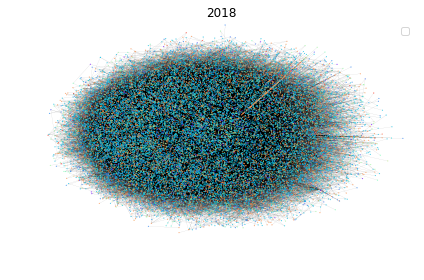

In [106]:
images=[]
version=8
for i in range(1950,2019):
    graficar_red_lims(Componente,G_year[str(i)],'campo',1,pos,[(-(i-1900 + 1)**5,(i-1900 + 1)**5),(-(i-1900 + 1)**5,(i-1900 + 1)**5)],str(i))
    images.append(imageio.imread(directorio+'fig'+str(i)+'.png'))
    images.append(imageio.imread(directorio+'fig'+str(i)+'.png'))
Final=50
for i in range(Final):
    images.append(imageio.imread(directorio+'fig'+str(2018)+'.png'))

imageio.mimsave(directorio+'Campos'+str(version)+'.gif', images)

In [134]:
import matplotlib.cm as cmx
import imageio
import random
def graficar_red_options(G,G_year,atributo,ancho,pos,lims,year_year,options):
    
    Componente=G.copy()
    campos_list=[]
    val_map = {}
    val_map_year = {}
    campos_list_year=[]

    ## Generas una lista de atributo de cada nodo
    for paper in Componente:
        campos_list.append(Componente.node[paper][atributo])
        val_map.update({paper: Componente.node[paper][atributo]})

    for paper in G_year:
        campos_list_year.append(G_year.node[paper][atributo])
        val_map_year.update({paper: G_year.node[paper][atributo]})
    
    grupo={}
    
    x={}
    sorted_by_value = []
    
    ## Asignamos los colores para cada valor de atributo, distinguiendo el año de cualquier otro atributo
    if atributo == 'year':
        y={}
        x=frequency(campos_list)
        
        for line in x.keys():
            y[line]=line
        sorted_by_value = sorted(y.items(), key=lambda kv: kv[1],reverse=True)
    else:   
        x=frequency(campos_list)
        sorted_by_value = sorted(x.items(), key=lambda kv: kv[1],reverse=True)
    
    random.seed(100)
    random.shuffle(sorted_by_value)
    
    cmap =[]
    cmap = cmx.Set1(np.linspace(0.0, 1.0, len(sorted_by_value)))
 
    ## A cada valor de atributo se le asigna un determinado color
    conversion={}
    for i in range(len(sorted_by_value)):
        conversion.update({sorted_by_value[i][0]: cmap[i]})
  

    ## Asigna un color a cada uno de los nodos de la red G_year (será el mismo para todos)
    color_map =[]  

    for paper in campos_list_year:
        color_map.append(conversion[paper])
    
    # Using a figure to use it as a parameter when calling nx.draw_networkx
    f = plt.figure(1)
    ax = f.add_subplot(1,1,1)
    for label in conversion:
        pass
#         ax.plot([ancho],[1],color=conversion[label],label=label,linestyle='',marker='.')
#         ax.legend(loc="lower right", bbox_to_anchor=(0.6,0.5))
    # Just fixed the color map
    nx.draw_networkx(G_year,pos=pos, node_color=color_map,with_labels=False,ax=ax, **options)
    
    # Setting it to how it was looking before.                                                                                                              
    plt.axis('off')
    f.set_facecolor('w')
    plt.title(year_year)
    plt.legend(numpoints = 1)
    f.tight_layout()
    plt.xlim(lims[0])
    plt.ylim(lims[1])
    plt.savefig(directorio+'fig'+year_year+'.png')
    plt.show()

4.449709755571369
0.943816560240366
0.44497097555713694


No handles with labels found to put in legend.


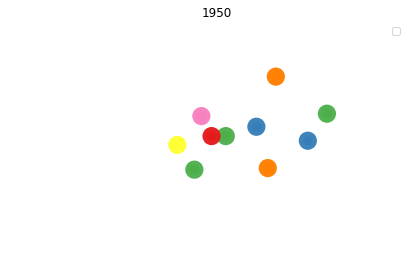

4.449709755571369
0.943816560240366
0.44497097555713694


No handles with labels found to put in legend.


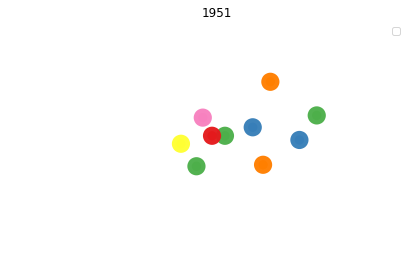

4.123227466996773
0.9393678854729565
0.4123227466996773


No handles with labels found to put in legend.


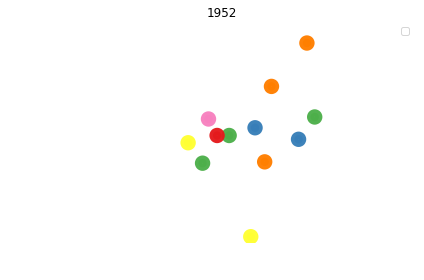

3.8823845303968936
0.935606584550644
0.3882384530396894


No handles with labels found to put in legend.


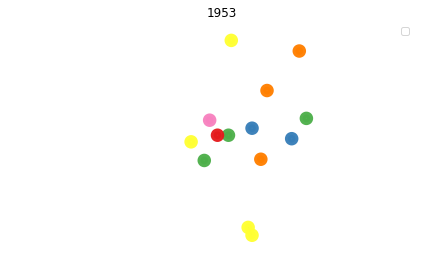

3.616330331361562
0.930869147148437
0.3616330331361562


No handles with labels found to put in legend.


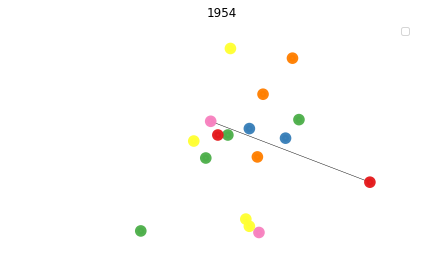

3.4201438632477177
0.9269036596131358
0.34201438632477177


No handles with labels found to put in legend.


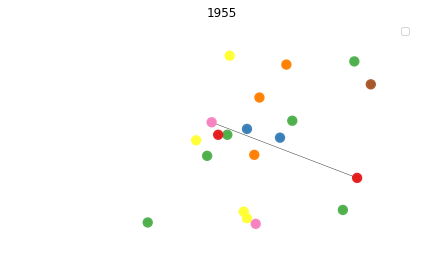

3.1830477187632233
0.9214589217351923
0.31830477187632233


No handles with labels found to put in legend.


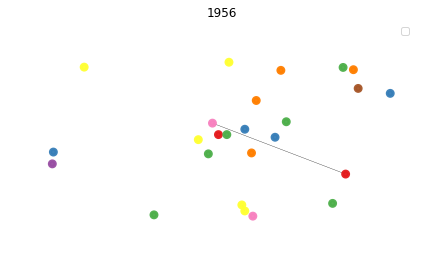

2.9836556577574553
0.9162101701146363
0.2983655657757455


No handles with labels found to put in legend.


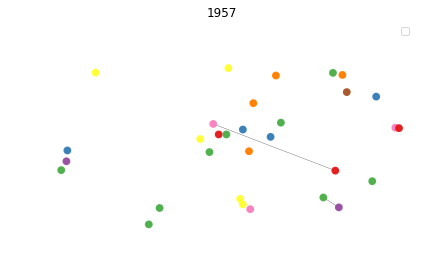

2.759024240620624
0.9093882553406765
0.2759024240620624


No handles with labels found to put in legend.


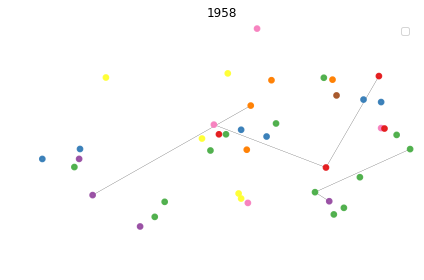

2.632658901620635
0.9050389703557484
0.26326589016206353


No handles with labels found to put in legend.


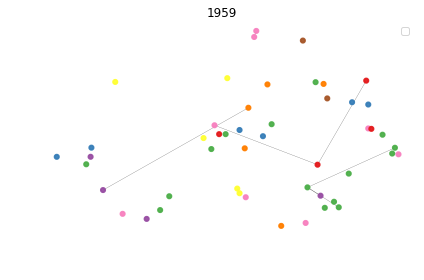

2.512750769865332
0.9005074426806768
0.25127507698653323


No handles with labels found to put in legend.


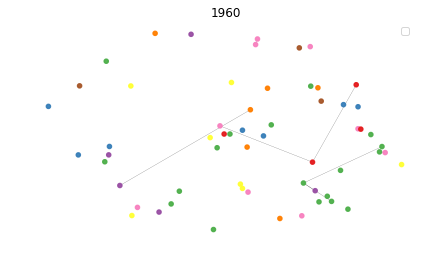

2.45445251934782
0.8981442916376202
0.24544525193478203


No handles with labels found to put in legend.


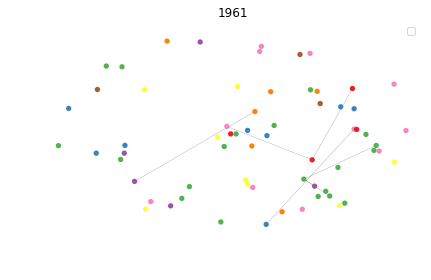

2.3805019509361744
0.8949801322776976
0.23805019509361747


No handles with labels found to put in legend.


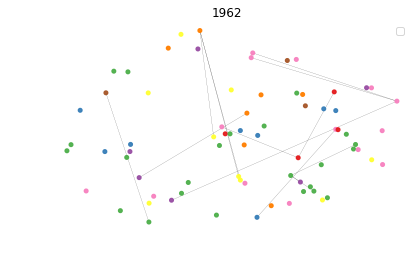

2.2604766573366386
0.8894038568420531
0.22604766573366386


No handles with labels found to put in legend.


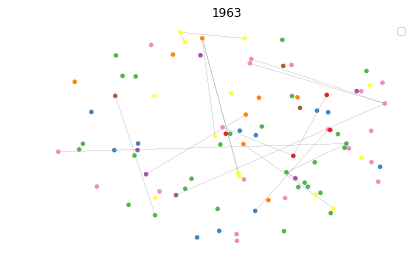

2.1714184173401367
0.8848678826689534
0.21714184173401369


No handles with labels found to put in legend.


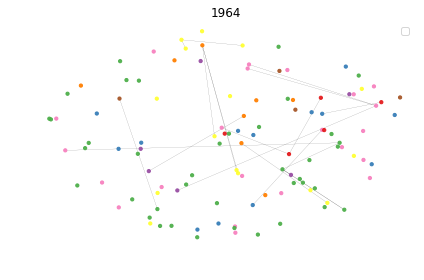

2.088738310107579
0.8803105210498466
0.2088738310107579


No handles with labels found to put in legend.


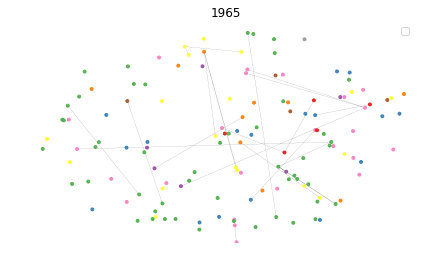

2.053095633126742
0.8782326570831652
0.20530956331267422


No handles with labels found to put in legend.


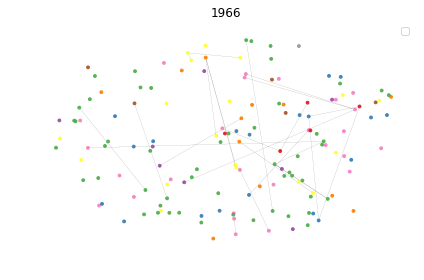

1.9772796860168504
0.8735636633664028
0.19772796860168507


No handles with labels found to put in legend.


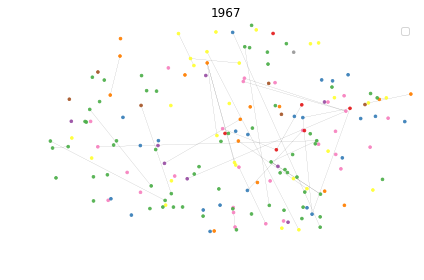

1.9127546586479978
0.8692984492968331
0.1912754658647998


No handles with labels found to put in legend.


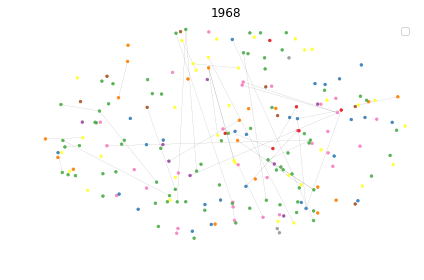

1.8529644180571376
0.8650810573782475
0.18529644180571378


No handles with labels found to put in legend.


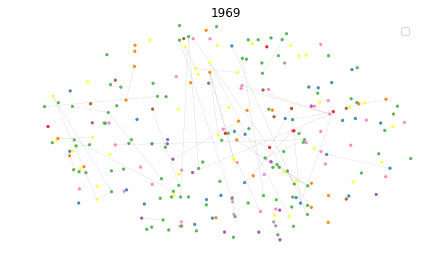

1.7973751023790028
0.8609082769261127
0.1797375102379003


No handles with labels found to put in legend.


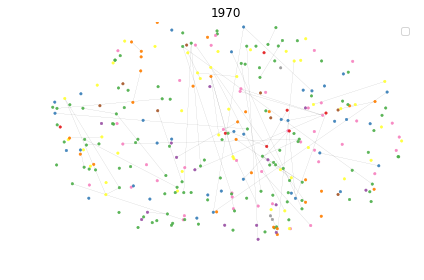

1.746508333786929
0.8568572533187239
0.17465083337869292


No handles with labels found to put in legend.


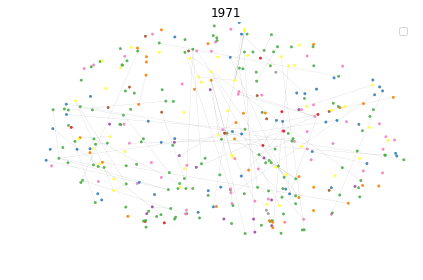

1.7093595738958327
0.8537463949552636
0.17093595738958328


No handles with labels found to put in legend.


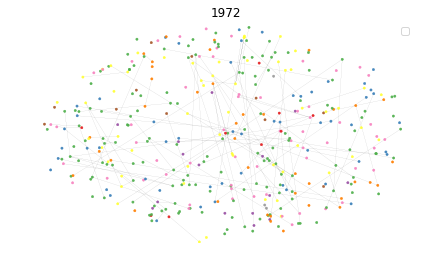

1.666404518688283
0.8499764029703973
0.1666404518688283


No handles with labels found to put in legend.


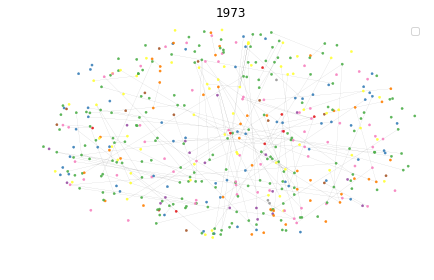

1.6353300509317021
0.8471256613565153
0.16353300509317023


No handles with labels found to put in legend.


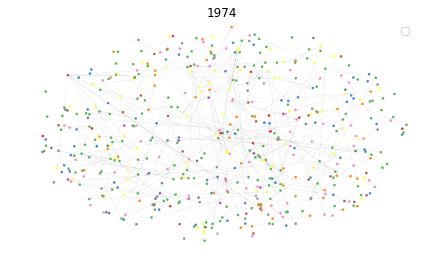

1.598370643545711
0.8435907209573007
0.15983706435457112


No handles with labels found to put in legend.


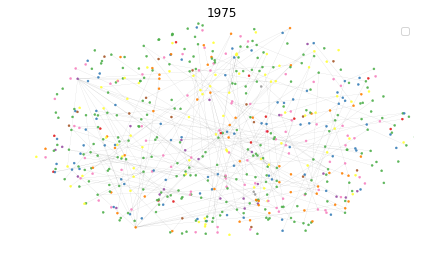

1.5643330850088033
0.8401874879488385
0.15643330850088033


No handles with labels found to put in legend.


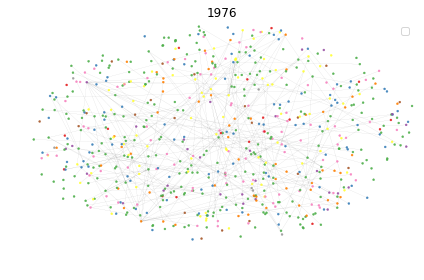

1.5262777001726033
0.8362028089831044
0.15262777001726036


No handles with labels found to put in legend.


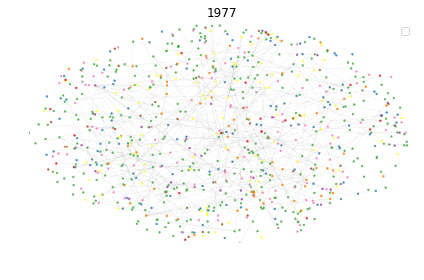

1.4959462981557397
0.8328817014967652
0.14959462981557398


No handles with labels found to put in legend.


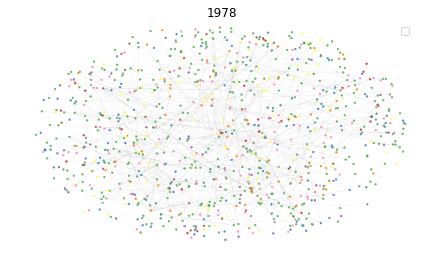

1.4688497998663772
0.8297987990176103
0.14688497998663771


No handles with labels found to put in legend.


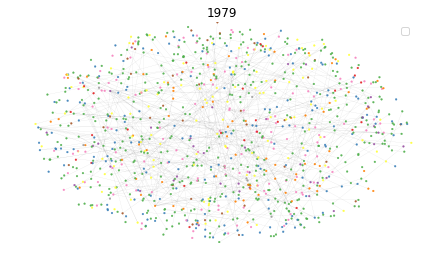

1.440244386319925
0.8264183479035849
0.14402443863199252


No handles with labels found to put in legend.


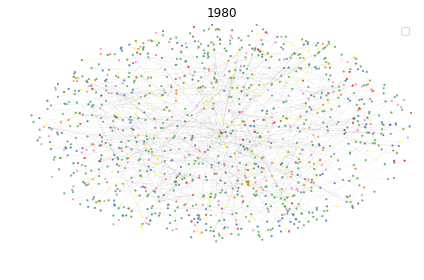

1.418586597149536
0.8237682489723629
0.1418586597149536


No handles with labels found to put in legend.


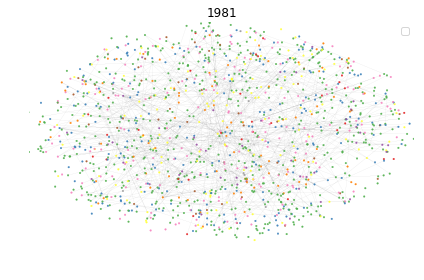

1.3969696289830473
0.821041206041113
0.13969696289830474


No handles with labels found to put in legend.


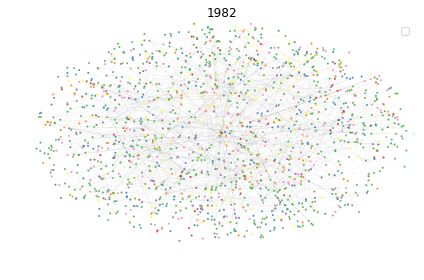

1.376884049433816
0.8184306077895218
0.1376884049433816


No handles with labels found to put in legend.


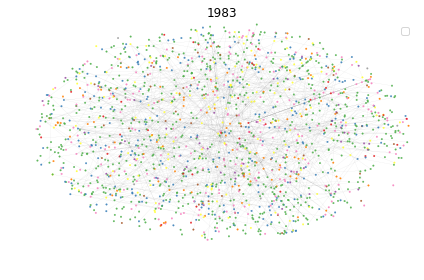

1.3570399584323103
0.815775505764173
0.13570399584323103


No handles with labels found to put in legend.


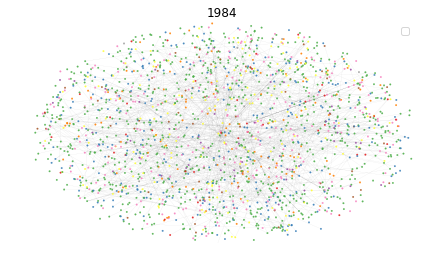

1.337556454697106
0.8130920013715508
0.1337556454697106


No handles with labels found to put in legend.


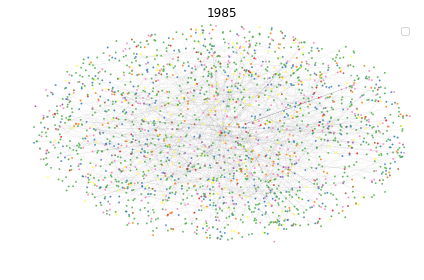

1.3221588594426723
0.81091530853911
0.13221588594426723


No handles with labels found to put in legend.


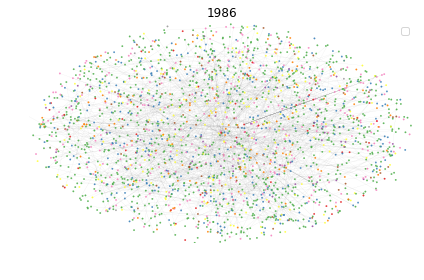

1.3062255308565087
0.808608854983816
0.13062255308565088


No handles with labels found to put in legend.


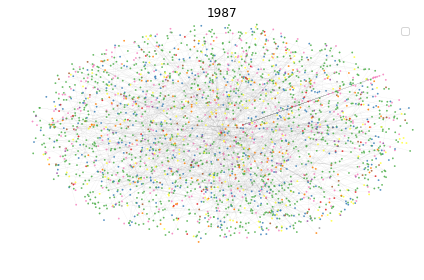

1.2906601532116662
0.806300675373062
0.12906601532116663


No handles with labels found to put in legend.


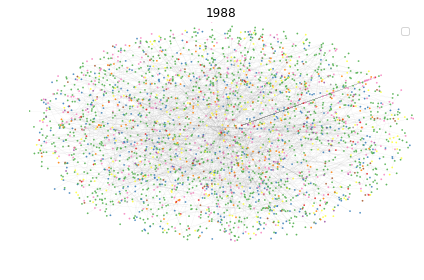

1.2756729105683164
0.8040249989406578
0.12756729105683165


No handles with labels found to put in legend.


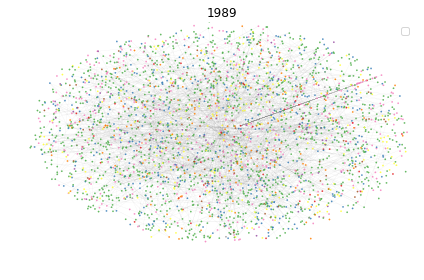

1.259286051275663
0.8014748120597788
0.1259286051275663


No handles with labels found to put in legend.


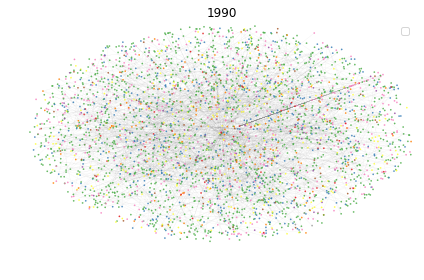

1.2421015009478236
0.7987282039275938
0.12421015009478237


No handles with labels found to put in legend.


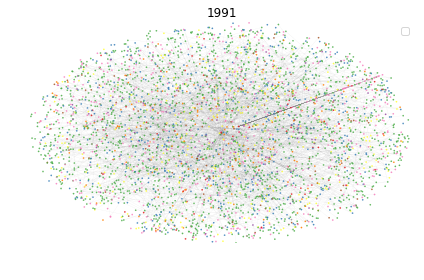

1.225328006877154
0.79597299776315
0.1225328006877154


No handles with labels found to put in legend.


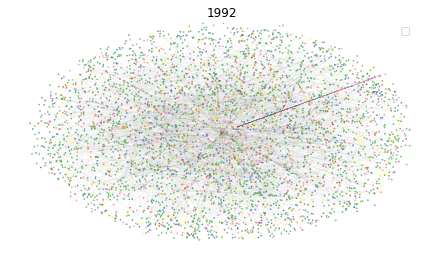

1.2100371580021887
0.7933947744110947
0.12100371580021888


No handles with labels found to put in legend.


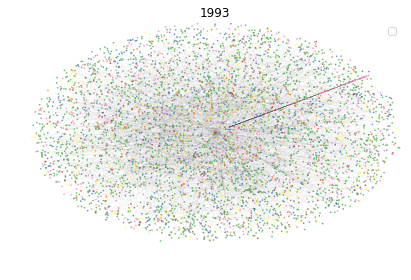

1.1964536057351969
0.7910491482481011
0.1196453605735197


No handles with labels found to put in legend.


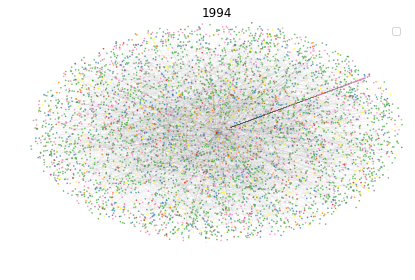

1.1825438477126815
0.7885913486560698
0.11825438477126815


No handles with labels found to put in legend.


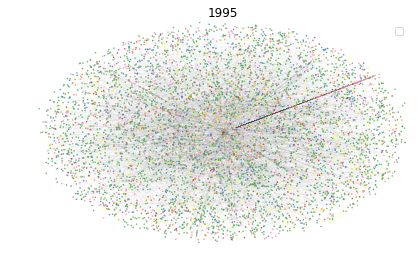

1.1682651307967626
0.7860074794584524
0.11682651307967627


No handles with labels found to put in legend.


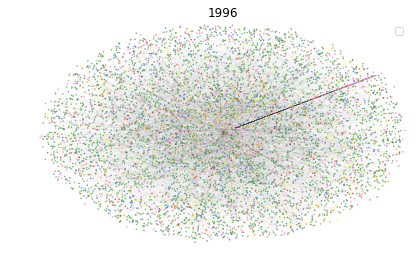

1.1531217239211118
0.7831972160320664
0.11531217239211118


No handles with labels found to put in legend.


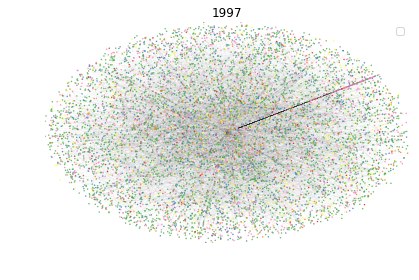

1.138536791694819
0.7804199198272271
0.11385367916948191


No handles with labels found to put in legend.


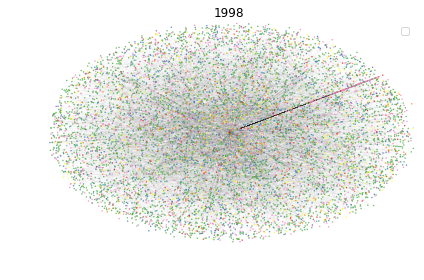

1.1244523156964294
0.7776695405307938
0.11244523156964295


No handles with labels found to put in legend.


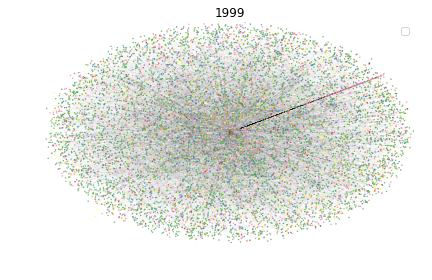

1.1107864056850227
0.774934227930324
0.11107864056850228


No handles with labels found to put in legend.


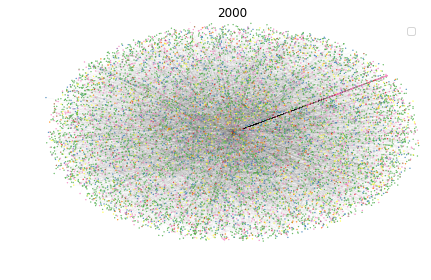

1.0986747056513966
0.7724531212796268
0.10986747056513967


No handles with labels found to put in legend.


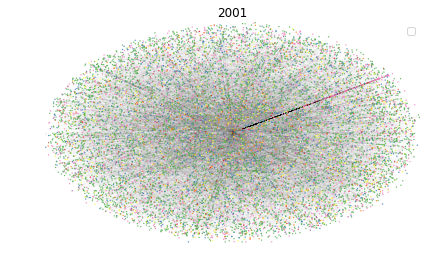

1.0870577843273008
0.7700214251676544
0.10870577843273009


No handles with labels found to put in legend.


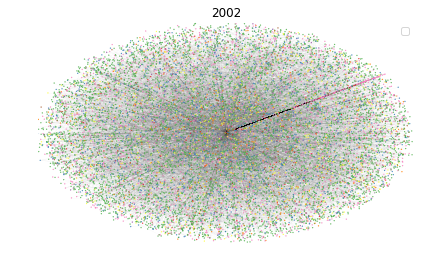

1.0756199813145289
0.7675759056702611
0.1075619981314529


No handles with labels found to put in legend.


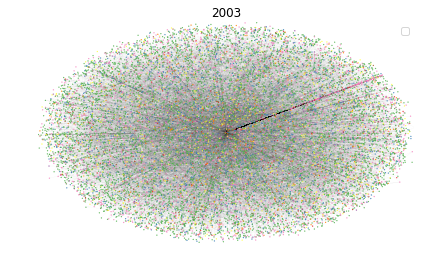

1.0651369023097346
0.7652883873820553
0.10651369023097346


No handles with labels found to put in legend.


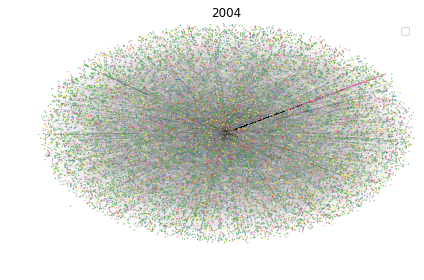

1.0551878357864353
0.763075358224089
0.10551878357864353


No handles with labels found to put in legend.


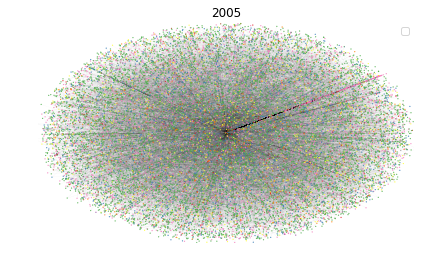

1.0452614841160108
0.7608253974732191
0.10452614841160109


No handles with labels found to put in legend.


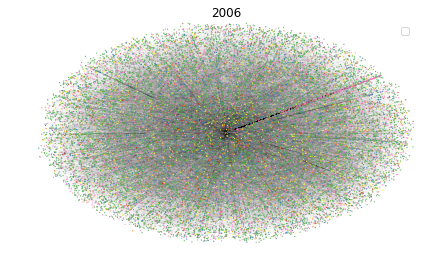

1.0363413635031655
0.7587667453946643
0.10363413635031656


No handles with labels found to put in legend.


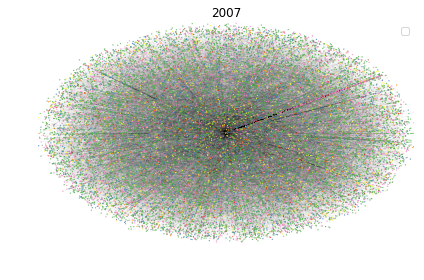

1.0282203827608178
0.7568614625896262
0.10282203827608179


No handles with labels found to put in legend.


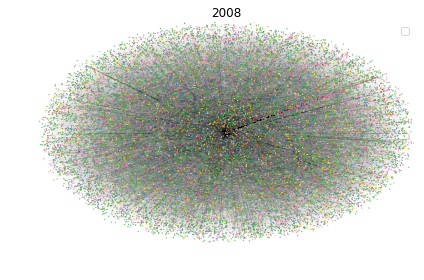

1.0209433090721178
0.7551284211586518
0.10209433090721179


No handles with labels found to put in legend.


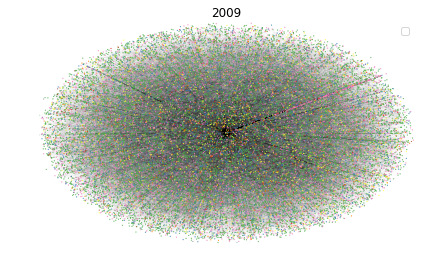

1.0150686931037753
0.7537112495947688
0.10150686931037754


No handles with labels found to put in legend.


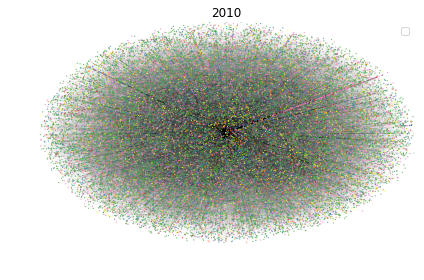

1.010317409209638
0.752553011834595
0.10103174092096381


No handles with labels found to put in legend.


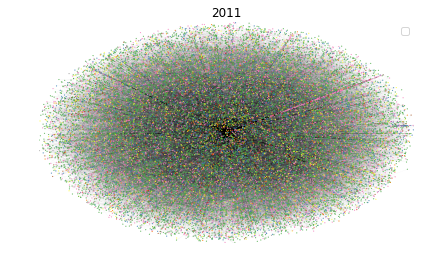

1.0063078186170809
0.7515670698618215
0.1006307818617081


No handles with labels found to put in legend.


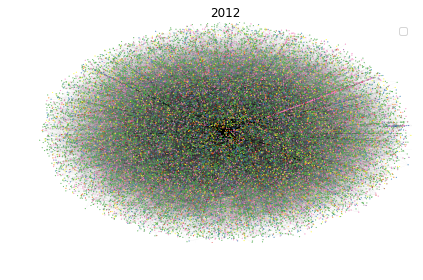

1.0034287305928973
0.7508542536426257
0.10034287305928974


No handles with labels found to put in legend.


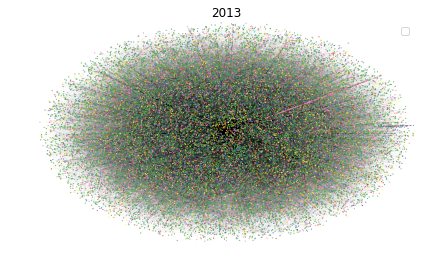

1.0015744590475
0.750392996005758
0.10015744590475001


No handles with labels found to put in legend.


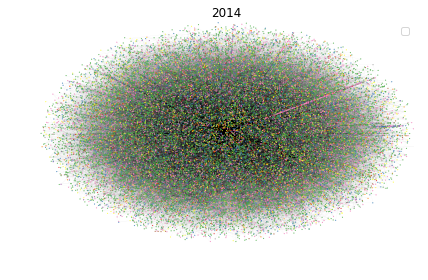

1.0004831047495684
0.7501207178680167
0.10004831047495684


No handles with labels found to put in legend.


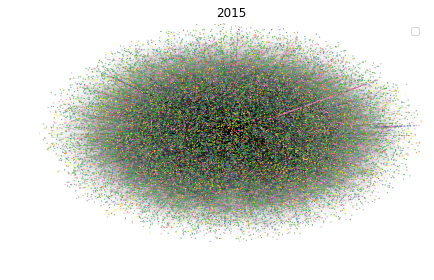

1.0000381273777375
0.750009531481024
0.10000381273777376


No handles with labels found to put in legend.


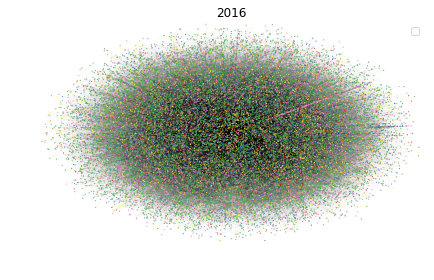

1.0
0.75
0.1


No handles with labels found to put in legend.


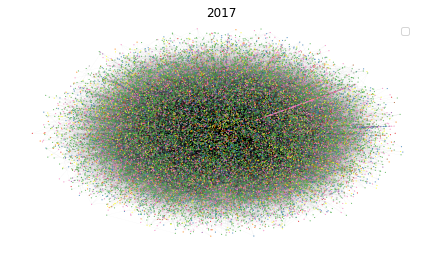

1.0
0.75
0.1


No handles with labels found to put in legend.


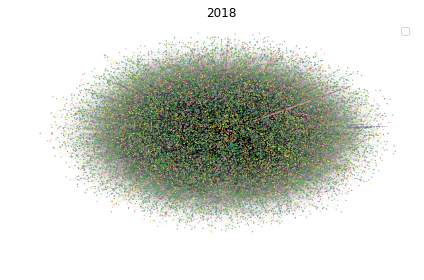

In [156]:
options = {
'node_size': 1,
'width': .05,
'alpha': .75,
'linewidths':.1
}
expo=3
images=[]
version=21
for i in range(1950,2019):
    options = {
    'node_size': (np.log(len(G_year['2018']))/np.log(len(G_year[str(i)])))**expo,
    'width': (np.log(len(G_year['2018']))/np.log(len(G_year[str(i)])))**expo*0.01,
    'alpha': 1-np.log(len(G_year[str(i)]))/(np.log(len(G_year['2018'])))*.15,
    'linewidths': (np.log(len(G_year['2018']))/np.log(len(G_year[str(i)])))**expo*.1}
    print(np.log(len(G_year['2018']))/np.log(len(G_year[str(i)])))
    print(1-np.log(len(G_year[str(i)]))/(np.log(len(G_year['2018'])))*.25)
    print((np.log(len(G_year['2018']))/np.log(len(G_year[str(i)])))*.1)
    graficar_red_options(Componente,G_year[str(i)],'campo',1,pos,[(-(i-1900 + 1)**5,(i-1900 + 1)**5),(-(i-1900 + 1)**5,(i-1900 + 1)**5)],str(i),options)
    images.append(imageio.imread(directorio+'fig'+str(i)+'.png'))
    images.append(imageio.imread(directorio+'fig'+str(i)+'.png'))
Final=50
for i in range(Final):
    images.append(imageio.imread(directorio+'fig'+str(2018)+'.png'))

imageio.mimsave(directorio+'Campos'+str(version)+'.gif', images)

In [99]:
G_year=red_year(Componente)

In [127]:
options

{'node_size': 1.0, 'width': 0.5, 'alpha': 0.75, 'linewidths': 1.0}

## Calculamos la cantidad de campos total y en la componente gigante

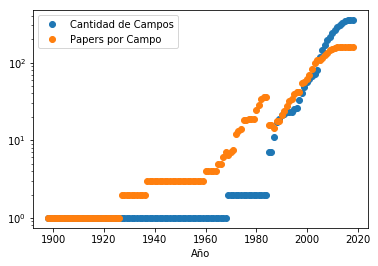

In [235]:
cantidad_de_campos=[]
for campo in campos:
    cantidad_de_campos.append(len(campo))
papers_por_campo=np.asarray(tamanos_gigante)/np.asarray(cantidad_de_campos)
plt.semilogy(years,cantidad_de_campos,'o',label='Cantidad de Campos')
plt.semilogy(years,papers_por_campo,'o',label='Papers por Campo')

plt.xlabel('Año');plt.ylabel('');plt.legend()
plt.show()

## Calculamos el tamaño de cada campo en la componente gigante

In [236]:
campos_tiempo={}
for cyear in campos:
    for campo in cyear.keys():
        campos_tiempo.update({campo:[]})

In [237]:
for campo in campos_tiempo:
    for cyear in campos:
        try:
            campos_tiempo[campo].append(cyear[campo])
        except KeyError:
            campos_tiempo[campo].append(0)

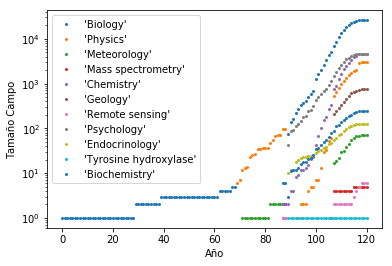

In [238]:
N=11
i=0
MS=2
for campo in campos_tiempo.keys():
    plt.semilogy(campos_tiempo[campo],'o',markersize=MS,label=campo)
    i+=1
    if i==N:
        break
plt.xlabel('Año');plt.ylabel('Tamaño Campo');plt.legend()
plt.show()

## Calculamos el tamaño de cada campo en las componentes 1 a 4

In [239]:
tamanos_gigante_1=[]
years_1=[]
campos_1=[]
tamanos_gigante_2=[]
years_2=[]
campos_2=[]
tamanos_gigante_3=[]
years_3=[]
campos_3=[]
tamanos_gigante_4=[]
years_4=[]
campos_4=[]
for i in G_year.keys():
    campo_1=[]
    if len(G_year[i])>1:
        GG=G_year[i].to_undirected()
        Componente=sorted(nx.connected_components(GG), key=len, reverse=True)[1]
        Componente=GG.subgraph(Componente)
        tamanos_gigante_1.append(len(Componente))
        years_1.append(int(i))
        for node in Componente.nodes:
            try:
                campo_1.append(G.nodes[node]['campo'])
            except KeyError:
                pass
        campos_1.append(Counter(campo_1))
    campo_2=[]
    if len(G_year[i])>2:
        GG=G_year[i].to_undirected()
        Componente=sorted(nx.connected_components(GG), key=len, reverse=True)[2]
        Componente=GG.subgraph(Componente)
        tamanos_gigante_2.append(len(Componente))
        years_2.append(int(i))
        for node in Componente.nodes:
            try:
                campo_2.append(G.nodes[node]['campo'])
            except KeyError:
                pass
        campos_2.append(Counter(campo_2))
    campo_3=[]
    if len(G_year[i])>3:
        GG=G_year[i].to_undirected()
        Componente=sorted(nx.connected_components(GG), key=len, reverse=True)[3]
        Componente=GG.subgraph(Componente)
        tamanos_gigante_3.append(len(Componente))
        years_3.append(int(i))
        for node in Componente.nodes:
            try:
                campo_3.append(G.nodes[node]['campo'])
            except KeyError:
                pass
        campos_3.append(Counter(campo_3))
    campo_4=[]
    if len(G_year[i])>4:
        GG=G_year[i].to_undirected()
        Componente=sorted(nx.connected_components(GG), key=len, reverse=True)[4]
        Componente=GG.subgraph(Componente)
        tamanos_gigante_4.append(len(Componente))
        years_4.append(int(i))
        for node in Componente.nodes:
            try:
                campo_4.append(G.nodes[node]['campo'])
            except KeyError:
                pass
        campos_4.append(Counter(campo_4))

In [240]:
def campos_dinamica(campos):
    campos_tiempo={}
    for cyear in campos:
        for campo in cyear.keys():
            campos_tiempo.update({campo:[]})
    for campo in campos_tiempo:
        for cyear in campos:
            try:
                campos_tiempo[campo].append(cyear[campo])
            except KeyError:
                campos_tiempo[campo].append(0)
    return(campos_tiempo)

In [241]:
campos_tiempo_1=campos_dinamica(campos_1)
campos_tiempo_2=campos_dinamica(campos_2)
campos_tiempo_3=campos_dinamica(campos_3)
campos_tiempo_4=campos_dinamica(campos_4)

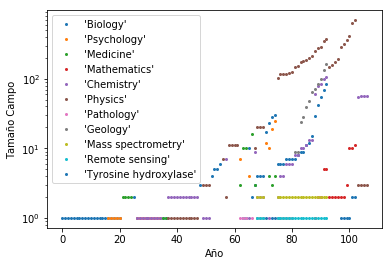

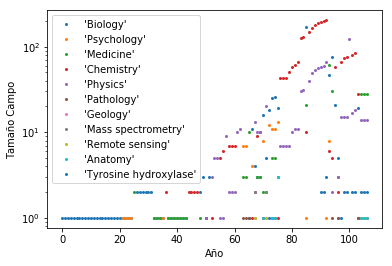

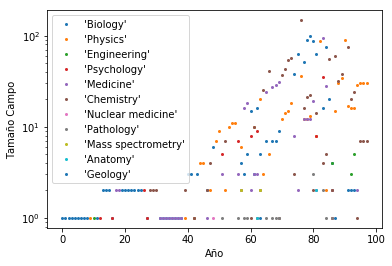

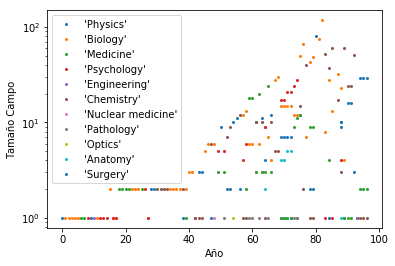

In [242]:
plt.figure()
N=11;i=0;MS=2
for campo in campos_tiempo_1.keys():
    plt.semilogy(campos_tiempo_1[campo],'o',markersize=MS,label=campo)
    i+=1
    if i==N:
        break
plt.xlabel('Año');plt.ylabel('Tamaño Campo');plt.legend()

plt.figure()
N=11;i=0;MS=2
for campo in campos_tiempo_2.keys():
    plt.semilogy(campos_tiempo_2[campo],'o',markersize=MS,label=campo)
    i+=1
    if i==N:
        break
plt.xlabel('Año');plt.ylabel('Tamaño Campo');plt.legend()

plt.figure()
N=11;i=0;MS=2
for campo in campos_tiempo_3.keys():
    plt.semilogy(campos_tiempo_3[campo],'o',markersize=MS,label=campo)
    i+=1
    if i==N:
        break
plt.xlabel('Año');plt.ylabel('Tamaño Campo');plt.legend()

plt.figure()
N=11;i=0;MS=2
for campo in campos_tiempo_4.keys():
    plt.semilogy(campos_tiempo_4[campo],'o',markersize=MS,label=campo)
    i+=1
    if i==N:
        break
plt.xlabel('Año');plt.ylabel('Tamaño Campo');plt.legend()

plt.show()

## Graficamos el tamaño total y de las componentes 0 a 4 en función del tiempo

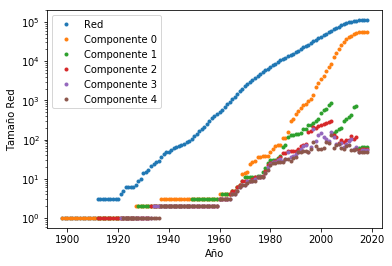

In [243]:
MS=3
plt.semilogy(years,tamanos_red,'o',markersize=MS,label='Red')       
plt.semilogy(years,tamanos_gigante,'o',markersize=MS,label='Componente 0')
plt.semilogy(years_1,tamanos_gigante_1,'o',markersize=MS,label='Componente 1')
plt.semilogy(years_2,tamanos_gigante_2,'o',markersize=MS,label='Componente 2')
plt.semilogy(years_3,tamanos_gigante_3,'o',markersize=MS,label='Componente 3')
plt.semilogy(years_4,tamanos_gigante_4,'o',markersize=MS,label='Componente 4')
plt.xlabel('Año');plt.ylabel('Tamaño Red');plt.legend()
plt.show()

## Graficamos el tamaño total y de todas las componentes

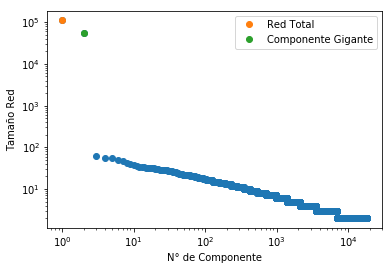

In [249]:
GG=G.copy()
GG=GG.to_undirected()
Componente_INT=sorted(nx.connected_components(GG), key=len, reverse=True)
Componentes=[]

for i in Componente_INT:
    Componentes.append(GG.subgraph(i))
largo=[len(GG)]
for i in Componentes:
    largo.append(len(i))

plt.loglog(range(1,len(largo)+1),largo,'o')
plt.loglog(1,largo[0],'o',label='Red Total')
plt.loglog(2,largo[1],'o',label='Componente Gigante')
plt.xlabel('N° de Componente');plt.ylabel('Tamaño Red');plt.legend()
plt.show()

## Graficamos el tamaño total y de todas las componentes

In [183]:
G.node['0000015a-5721-4f2a-ac3f-a67ccd9812e0']['campo']

"'Chemistry'"